In [2]:
from sklearn.utils import shuffle 
import os
import seaborn as sns
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn import model_selection
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_curve, auc,roc_auc_score
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV, cross_val_score,train_test_split,cross_validate, StratifiedKFold
from sklearn.utils  import shuffle
import joblib
import warnings
from sklearn.exceptions import DataConversionWarning
# 忽略特定类型的警告
warnings.filterwarnings("ignore", category=DataConversionWarning)
# 模型扰动
from y_scramble import Scrambler  # 确保y_scramble已正确安装和可用

In [3]:
from matplotlib import font_manager, pyplot as plt

# 查找系统中所有可用的Times New Roman字体的路径
times_new_roman = font_manager.findSystemFonts(fontpaths=None, fontext='ttf')
# 从列表中找到一个指定的字体名称，并确保字体能支持加粗
t_nr_path = [f for f in times_new_roman if 'Times New Roman' in f and 'Bold' in f]

if t_nr_path:
    # 如果找到了Times New Roman Bold字体，设置为默认字体
    prop = font_manager.FontProperties(fname=t_nr_path[0])
    plt.rcParams['font.family'] = prop.get_name()
    plt.rcParams['font.weight'] = 'bold'  # 设置字体为加粗
else:
    # 如果没有找到加粗的Times New Roman，尝试设置为普通的Times New Roman并加粗
    t_nr_path = [f for f in times_new_roman if 'Times New Roman' in f]
    if t_nr_path:
        prop = font_manager.FontProperties(fname=t_nr_path[0])
        plt.rcParams['font.family'] = prop.get_name()
        plt.rcParams['font.weight'] = 'bold'
    else:
        # 如果没有找到Times New Roman，使用默认的衬线字体并设置为加粗
        plt.rcParams['font.family'] = 'serif'
        plt.rcParams['font.weight'] = 'bold'

#### XYT-MACCS-AdaBoost

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 设置字体大小
plt.rcParams['font.size'] = 10
# 假设 'results' 已经包含所需的数据列
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

# 散点图
scatter = ax.scatter(
    results['accuracy'],
    results['mcc'],
    results['roc_auc'],
    c=results['significancy'],
    cmap='PiYG_r',   #内置颜色
    marker='o'
)

# 添加轴标签，使用字体大小12和粗体
ax.set_xlabel('Accuracy', fontsize=12, fontweight='bold')
ax.set_ylabel('MCC', fontsize=12, fontweight='bold')
ax.set_zlabel('AUC-ROC', fontsize=12, fontweight='bold')

# 添加标题，使用字体大小15和粗体
ax.set_title('MACCs-Ada', fontsize=15, fontweight='bold')

# # 绘制立方体边框
max_range = np.array([results['accuracy'].max()-results['accuracy'].min(), 
                      results['mcc'].max()-results['mcc'].min(), 
                      results['roc_auc'].max()-results['roc_auc'].min()]).max() / 2.0
mid_x = (results['accuracy'].max()+results['accuracy'].min()) * 0.5
mid_y = (results['mcc'].max()+results['mcc'].min()) * 0.5
mid_z = (results['roc_auc'].max()+results['roc_auc'].min()) * 0.5
ax.set_xlim(mid_x - max_range, mid_x + max_range)
ax.set_ylim(mid_y - max_range, mid_y + max_range)
ax.set_zlim(mid_z - max_range, mid_z + max_range)
# 生成各顶点
x = [mid_x - max_range, mid_x + max_range]
y = [mid_y - max_range, mid_y + max_range]
z = [mid_z - max_range, mid_z + max_range]
# 绘制线条
for xi in x:
    for yi in y:
        ax.plot([xi, xi], [yi, yi], z, linestyle="-", color="black")

for xi in x:
    for zi in z:
        ax.plot([xi, xi], y, [zi, zi], linestyle="-", color="black")

for yi in y:
    for zi in z:
        ax.plot(x, [yi, yi], [zi, zi], linestyle="-", color="black")

# 更改网格线为虚线
ax.xaxis._axinfo["grid"]['linestyle'] = "--"
ax.yaxis._axinfo["grid"]['linestyle'] = "--"
ax.zaxis._axinfo["grid"]['linestyle'] = "--"
ax.grid(True)
# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# Saving the plot as SVG with a high quality
plt.savefig("MACCs_Ada.svg", format='svg', dpi=600)
plt.show()


### MACCS-SVM

In [7]:
from sklearn.svm import SVC
def train_model(X_train, Y_train):
    """Train AdaBoost model with specified parameters."""
    ###########   修改模型
    model = SVM = SVC(random_state=0,        # 随机数种子
          class_weight='balanced',  # 类别权重平衡
          gamma='auto',             # 核函数的系数
          C=100,                     # 正则化参数
          kernel='poly',         # 使用sigmoid核
          shrinking=False,           # 是否使用shrinking heuristic方法
          probability=True)         # 是否启用概率估计
    model.fit(X_train, Y_train)
    return model

def save_results_to_csv(data, filename):
    """Save DataFrame to a CSV file."""
    data.to_csv(filename, index=False)
    print(f"Data saved to {filename}.")
    
#模型扰动
def scramble_and_validate(model, X, Y, dataset_name="train"):
    """Scramble model and validate on specified dataset."""
    #scrambler = Scrambler(model=mlp, iterations=100)
    scrambler = Scrambler(model=model, iterations=100)
    results = scrambler.validate(X, Y, scoring="accuracy", 
                                 cross_val_score_aggregator="mean", 
                                 pvalue_threshold=0.01, 
                                 as_df=True)
    # Save results to CSV file specific to the dataset
    results_filename = f"{dataset_name}_validation_results.csv"
    save_results_to_csv(results, results_filename)
    return results

# 存储原始模型的数据
def process_original_model_results(results, filename):
    original_model_data = results.iloc[0]
    original_model_metrics_df = pd.DataFrame({
        #'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'f1', 'Z-Score', 'P-Value', 'Significance'],
        'Metric': ['Accuracy', 'ROC AUC', 'MCC','P-Value', 'Significance'],
        'Value': [
            original_model_data['accuracy'],
            #original_model_data['recall'],
            #original_model_data['precision'],
            original_model_data['roc_auc'],
            original_model_data['mcc'],
            #original_model_data['f1'],
            #original_model_data['zscore'],
            original_model_data['pvalue'],
            '显著' if original_model_data['significancy'] else '不显著'
        ]
    })
    original_model_metrics_df.to_csv(filename, index=False)
    print(f"Original model metrics saved to {filename}.")
        
#随机提取训练集和测试集10次的扰动结果保存
def save_random_samples(results, dataset_name):
    """Save 10 random non-original model results to CSV."""
    if len(results) > 1:  # 除去原始模型至少还有1条数据
        # 排除第一行（原始模型数据）
        random_indices = np.random.choice(results.index[1:], size=min(10, len(results) - 1), replace=False)
        selected_scrambled_metrics = results.iloc[random_indices]
        filename = f"{dataset_name}_random_scrambled_metrics.csv"
        selected_scrambled_metrics.to_csv(filename, index=False)
        print(f"Random scrambled results saved to {filename}.")
    else:
        print(f"Not enough data to select from in {dataset_name} results.")

############# 读取数据
data = pd.read_csv('./MACCS-SVM/MGAM-train-MACCs.csv')
data2 = pd.read_csv('./MACCS-SVM/MGAM-test-MACCs.csv')

# 设置训练集和测试集的特征和标签
X_train = data.iloc[:, 2:]
Y_train = data.iloc[:, 1:2].values.ravel()
X_test = data2.iloc[:, 2:]
Y_test = data2.iloc[:, 1:2].values.ravel()

# 训练模型
model = train_model(X_train, Y_train)

# 验证模型并保存结果
train_results = scramble_and_validate(model, X_train, Y_train, "train")
test_results = scramble_and_validate(model, X_test, Y_test, "test")
    
# 保存原始模型指标
process_original_model_results(train_results, "original_train_model_metrics.csv")
process_original_model_results(test_results, "original_test_model_metrics.csv")

# 使用前面定义的函数来随机选取并保存扰动结果
save_random_samples(train_results, "train")
save_random_samples(test_results, "test")

Data saved to train_validation_results.csv.
Data saved to test_validation_results.csv.
Original model metrics saved to original_train_model_metrics.csv.
Original model metrics saved to original_test_model_metrics.csv.
Random scrambled results saved to train_random_scrambled_metrics.csv.
Random scrambled results saved to test_random_scrambled_metrics.csv.


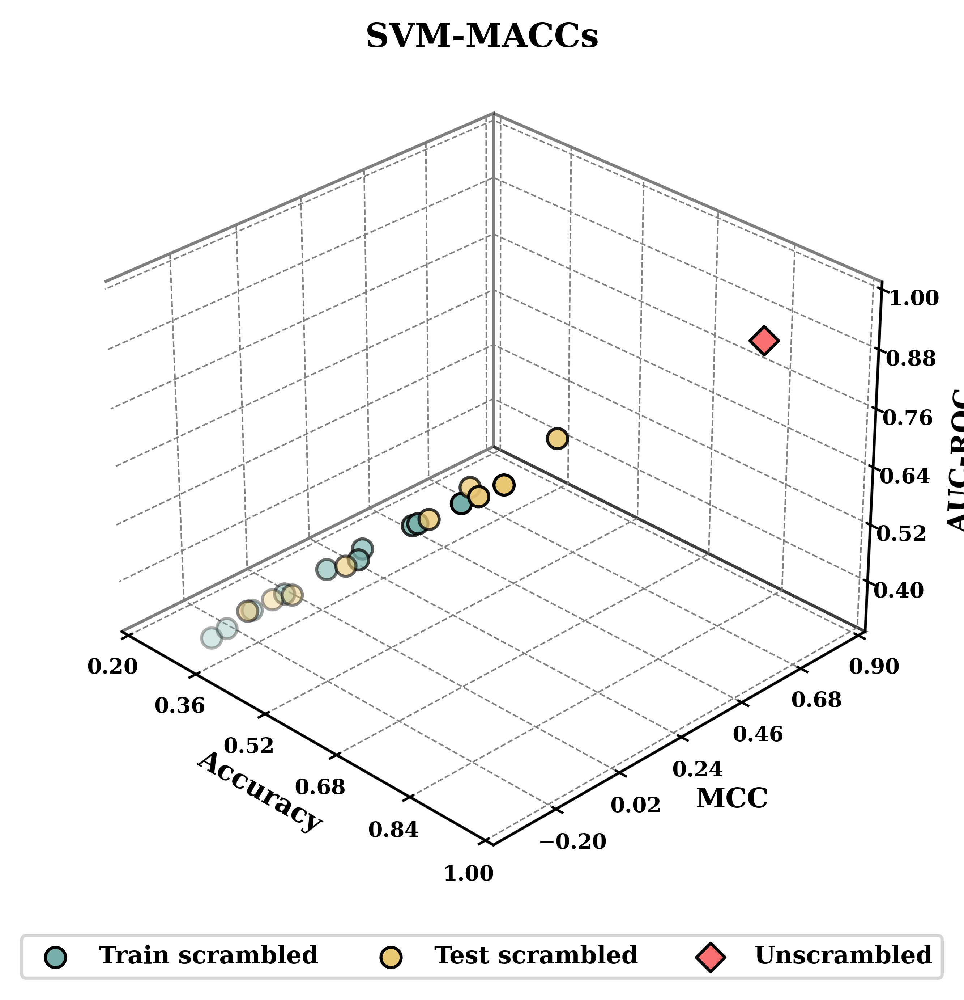

In [31]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./MACCS-SVM/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./MACCS-SVM/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./MACCS-SVM/original_train_model_metrics.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('SVM-MACCs', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))   #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))#MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./MACCS-SVM/MACCs-SVM.svg", format='svg', dpi=600)
plt.show()

In [28]:
# import matplotlib.pyplot as plt
# from mpl_toolkits.mplot3d import Axes3D
# import pandas as pd
# import numpy as np

# # 加载结果数据
# train_results = pd.read_csv('./MACCS-SVM/train_random_scrambled_metrics.csv')
# test_results = pd.read_csv('./MACCS-SVM/test_random_scrambled_metrics.csv')
# original_train = pd.read_csv('./MACCS-SVM/original_train_model_metrics.csv', encoding='ISO-8859-1')

# # 创建一个大小为5*5，dpi为600的绘图窗口
# fig = plt.figure(figsize=(5, 5), dpi=600)
# # 在绘图窗口上创建一个3D坐标系
# ax = fig.add_subplot(111, projection='3d')
# # 设定3D坐标系的所有边框颜色为黑色
# ax.xaxis.pane.set_edgecolor('k')
# ax.yaxis.pane.set_edgecolor('k')
# ax.zaxis.pane.set_edgecolor('k')

# # 读取训练集、测试集和原始数据的扰动指标
# scatter_train = ax.scatter(
#     train_results['accuracy'],
#     train_results['mcc'],
#     train_results['roc_auc'],
#     c='#77B0AA',  # Color for training data
#     label='Train scrambled',
#     marker='o',
#     s=45,  # 设置点的大小为100，可以根据需要调整大小
#     depthshade=True,  # 启用深度阴影
#     edgecolors='k'  # 点的边缘颜色设置为黑色
# )
# scatter_test = ax.scatter(
#     test_results['accuracy'],
#     test_results['mcc'],
#     test_results['roc_auc'],
#     c='#E9C874',  # Color for testing data
#     label='Test scrambled',
#     marker='o',
#     s=45,  # 设置点的大小为100，可以根据需要调整大小
#     depthshade=True,  # 启用深度阴影
#     edgecolors='k'  # 点的边缘颜色设置为黑色
# )

# # 读取原始指标
# accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
# mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
# roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
# scatter_original_train = ax.scatter(
#     accuracy,
#     mcc,
#     roc_auc,
#     c='#FA7070',  # Color for original training data
#     label='Unscrambled',
#     marker='D',  # Diamond shape,
#     s=45,  # 设置点的大小为100，可以根据需要调整大小
#     depthshade=True,  # 启用深度阴影
#     edgecolors='k'  # 点的边缘颜色设置为黑色
# )

# # 将三维图的墙壁设置为透明
# ax.xaxis.pane.fill = False
# ax.yaxis.pane.fill = False
# ax.zaxis.pane.fill = False

# # 绘制立方体的边框
# max_range = np.array([train_results['accuracy'].max()-train_results['accuracy'].min(), 
#                       train_results['mcc'].max()-train_results['mcc'].min(), 
#                       train_results['roc_auc'].max()-train_results['roc_auc'].min()]).max() / 2.0

# mid_x = (train_results['accuracy'].max()+train_results['accuracy'].min()) * 0.5
# mid_y = (train_results['mcc'].max()+train_results['mcc'].min()) * 0.5
# mid_z = (train_results['roc_auc'].max()+train_results['roc_auc'].min()) * 0.5

# x_r = [mid_x - max_range, mid_x + max_range]
# y_r = [mid_y - max_range, mid_y + max_range]
# z_r = [mid_z - max_range, mid_z + max_range]

# # 画出立方体的边框
# for xc in x_r:
#     for yc in y_r:
#         ax.plot([xc, xc], [yc, yc], z_r, color='k')
# for xc in x_r:
#     for zc in z_r:
#         ax.plot([xc, xc], y_r, [zc, zc], color='k')
# for yc in y_r:
#     for zc in z_r:
#         ax.plot(x_r, [yc, yc], [zc, zc], color='k')

# # 设置网格线虚线样式和强度
# ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
# ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
# ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
# ax.grid(True)

# # 设置图的标题和标签
# plt.title('MACCs-SVM', fontsize=11, fontweight='bold', pad=-100)
# ax.set_xlabel('Accuracy', fontsize=9, fontweight='bold', labelpad=-6)
# ax.set_ylabel('MCC', fontsize=9, fontweight='bold', labelpad=-4)
# ax.set_zlabel('AUC-ROC', fontsize=9, fontweight='bold', labelpad=-4)

# # 设置视角
# ax.view_init(azim=-45, elev=30)

# # 设置刻度标签大小和距离
# ax.tick_params(axis='both', which='major', labelsize=7)
# ax.tick_params(axis='x', which='major', pad=-2)
# ax.tick_params(axis='y', which='major', pad=-2)
# ax.tick_params(axis='z', which='major', pad=-2)

# # 保存图形
# plt.savefig("./MACCS-SVM/MACCs-SVM5.svg", format='svg', dpi=600)
# plt.show()


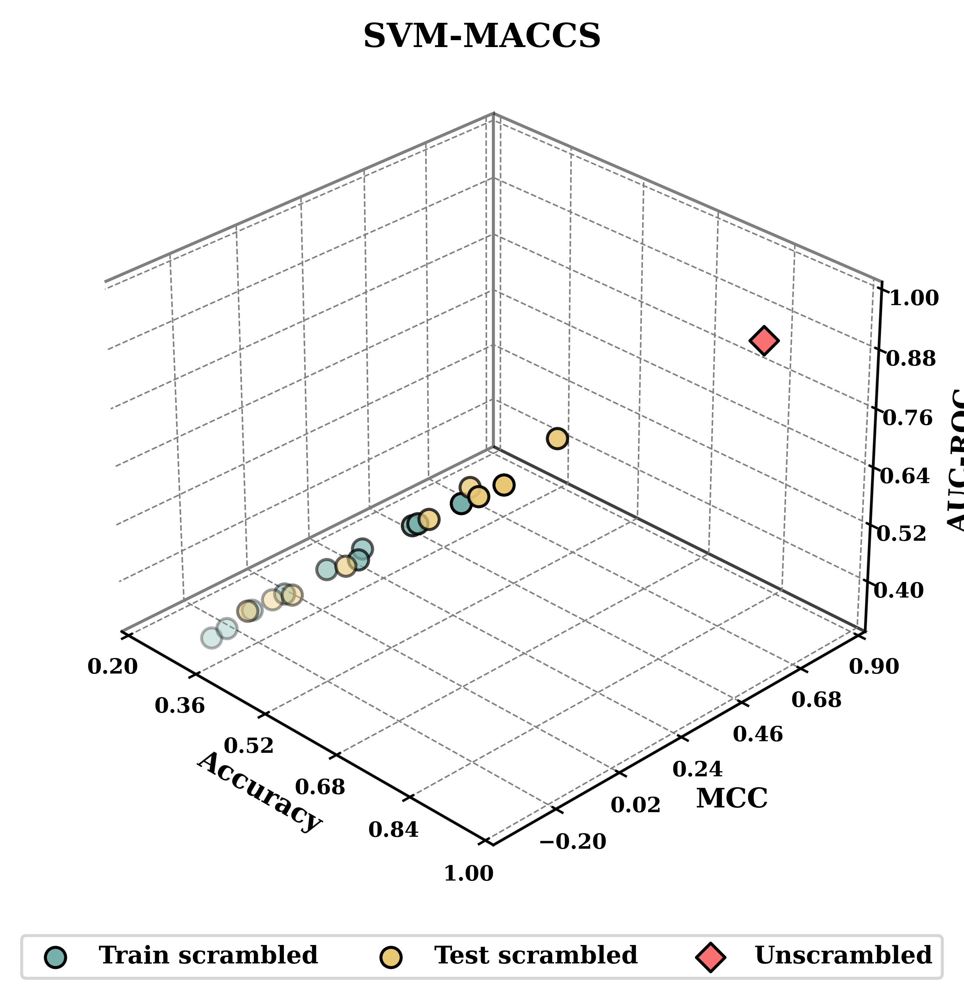

In [32]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./MACCS-SVM/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./MACCS-SVM/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./MACCS-SVM/original_train_model_metrics.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('SVM-MACCS', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))   #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))#MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./MACCS-SVM/MACCS-SVM.svg", format='svg', dpi=600)
plt.show()

### FCFPs-DNN

In [33]:
from sklearn.neural_network import MLPClassifier
def train_model(X_train, Y_train):
    """Train AdaBoost model with specified parameters."""
    ###########   修改模型
    model = mlp = MLPClassifier(
    random_state=0,
    activation='identity',
    hidden_layer_sizes = (65, 110, 200),
    learning_rate = 'constant',
    solver = 'sgd')
    model.fit(X_train, Y_train)
    return model

def save_results_to_csv(data, filename):
    """Save DataFrame to a CSV file."""
    data.to_csv(filename, index=False)
    print(f"Data saved to {filename}.")
    
#模型扰动
def scramble_and_validate(model, X, Y, dataset_name="train"):
    """Scramble model and validate on specified dataset."""
    #scrambler = Scrambler(model=mlp, iterations=100)
    scrambler = Scrambler(model=model, iterations=100)
    results = scrambler.validate(X, Y, scoring="accuracy", 
                                 cross_val_score_aggregator="mean", 
                                 pvalue_threshold=0.01, 
                                 as_df=True)
    # Save results to CSV file specific to the dataset
    results_filename = f"{dataset_name}_validation_results.csv"
    save_results_to_csv(results, results_filename)
    return results

# 存储原始模型的数据
def process_original_model_results(results, filename):
    original_model_data = results.iloc[0]
    original_model_metrics_df = pd.DataFrame({
        #'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'f1', 'Z-Score', 'P-Value', 'Significance'],
        'Metric': ['Accuracy', 'ROC AUC', 'MCC','P-Value', 'Significance'],
        'Value': [
            original_model_data['accuracy'],
            #original_model_data['recall'],
            #original_model_data['precision'],
            original_model_data['roc_auc'],
            original_model_data['mcc'],
            #original_model_data['f1'],
            #original_model_data['zscore'],
            original_model_data['pvalue'],
            '显著' if original_model_data['significancy'] else '不显著'
        ]
    })
    original_model_metrics_df.to_csv(filename, index=False)
    print(f"Original model metrics saved to {filename}.")
        
#随机提取训练集和测试集10次的扰动结果保存
def save_random_samples(results, dataset_name):
    """Save 10 random non-original model results to CSV."""
    if len(results) > 1:  # 除去原始模型至少还有1条数据
        # 排除第一行（原始模型数据）
        random_indices = np.random.choice(results.index[1:], size=min(10, len(results) - 1), replace=False)
        selected_scrambled_metrics = results.iloc[random_indices]
        filename = f"{dataset_name}_random_scrambled_metrics.csv"
        selected_scrambled_metrics.to_csv(filename, index=False)
        print(f"Random scrambled results saved to {filename}.")
    else:
        print(f"Not enough data to select from in {dataset_name} results.")

############# 读取数据
data = pd.read_csv('./FCFPs/MGAM-train-FCFPs.csv')
data2 = pd.read_csv('./FCFPs/MGAM-test-FCFPs.csv')

# 设置训练集和测试集的特征和标签
X_train = data.iloc[:, 2:]
Y_train = data.iloc[:, 1:2].values.ravel()
X_test = data2.iloc[:, 2:]
Y_test = data2.iloc[:, 1:2].values.ravel()

# 训练模型
model = train_model(X_train, Y_train)

# 验证模型并保存结果
train_results = scramble_and_validate(model, X_train, Y_train, "train")
test_results = scramble_and_validate(model, X_test, Y_test, "test")
    
# 保存原始模型指标
process_original_model_results(train_results, "original_train_model_metrics.csv")
process_original_model_results(test_results, "original_test_model_metrics.csv")

# 使用前面定义的函数来随机选取并保存扰动结果
save_random_samples(train_results, "train")
save_random_samples(test_results, "test")

/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/md04/a

Data saved to train_validation_results.csv.


/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/md04/a

Data saved to test_validation_results.csv.
Original model metrics saved to original_train_model_metrics.csv.
Original model metrics saved to original_test_model_metrics.csv.
Random scrambled results saved to train_random_scrambled_metrics.csv.
Random scrambled results saved to test_random_scrambled_metrics.csv.


/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


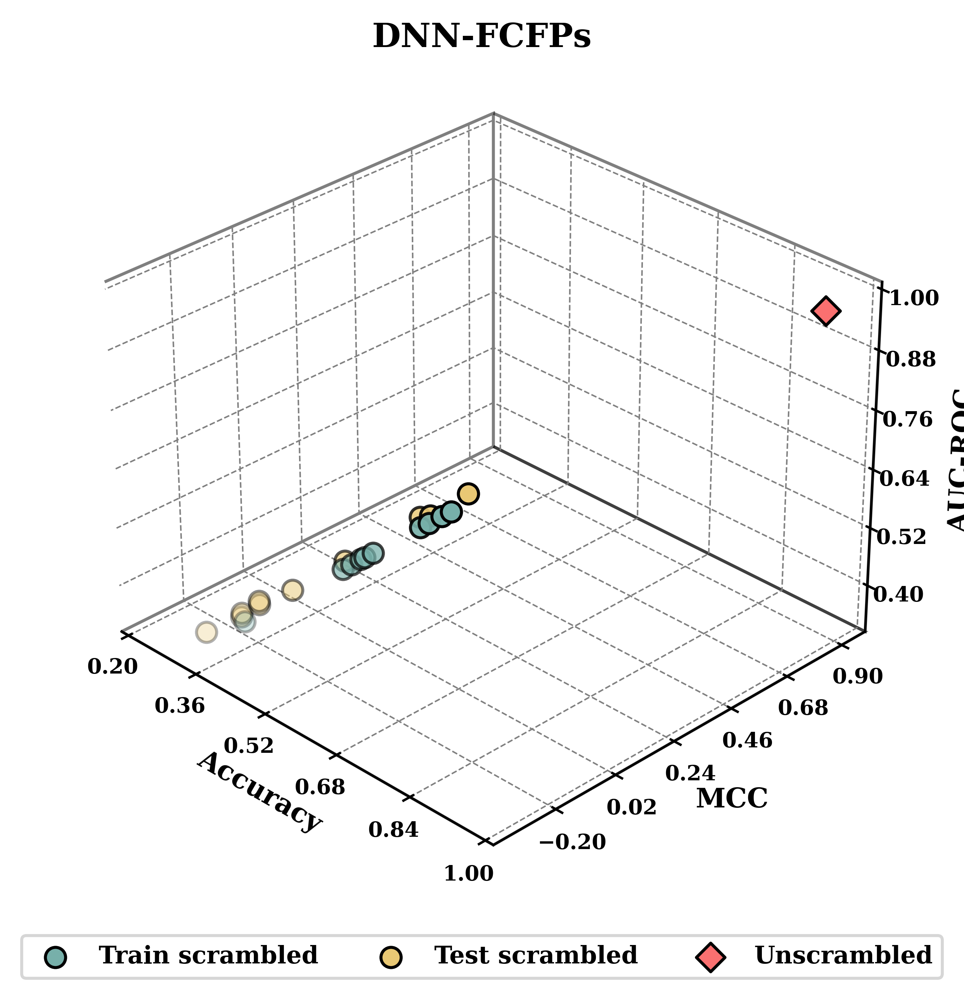

In [34]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./FCFPs-DNN/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./FCFPs-DNN/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./FCFPs-DNN/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('DNN-FCFPs', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))   #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))#MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./FCFPs-DNN/DNN-FCFPs.svg", format='svg', dpi=600)
plt.show()

### FCFPs-RF

In [41]:
from sklearn.ensemble import RandomForestClassifier
def train_model(X_train, Y_train):
    """Train AdaBoost model with specified parameters."""
    ###########   修改模型
    model = RF = RandomForestClassifier(
    random_state=0,  # 设置随机种子，确保结果可重复
    class_weight='balanced',  # 类别权重，处理不平衡数据集
    criterion='gini',  # 评价分裂质量的标准，这里使用基尼不纯度
    max_features='sqrt',  # 寻找最佳分裂时考虑的特征数，这里使用log2
    bootstrap=True,  # 是否使用bootstrap样本
    max_depth=25,  # 树的最大深度
    min_samples_leaf=3,  # 叶节点最少样本数
    min_samples_split=5,  # 分裂内部节点所需的最小样本数
    n_estimators=143,  # 构建的树的数量
    oob_score=True  # 是否使用袋外样本来评估精度
)
    model.fit(X_train, Y_train)
    return model

def save_results_to_csv(data, filename):
    """Save DataFrame to a CSV file."""
    data.to_csv(filename, index=False)
    print(f"Data saved to {filename}.")
    
#模型扰动
def scramble_and_validate(model, X, Y, dataset_name="train"):
    """Scramble model and validate on specified dataset."""
    #scrambler = Scrambler(model=mlp, iterations=100)
    scrambler = Scrambler(model=model, iterations=100)
    results = scrambler.validate(X, Y, scoring="accuracy", 
                                 cross_val_score_aggregator="mean", 
                                 pvalue_threshold=0.01, 
                                 as_df=True)
    # Save results to CSV file specific to the dataset
    results_filename = f"{dataset_name}_validation_results.csv"
    save_results_to_csv(results, results_filename)
    return results

# 存储原始模型的数据
def process_original_model_results(results, filename):
    original_model_data = results.iloc[0]
    original_model_metrics_df = pd.DataFrame({
        #'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'f1', 'Z-Score', 'P-Value', 'Significance'],
        'Metric': ['Accuracy', 'ROC AUC', 'MCC','P-Value', 'Significance'],
        'Value': [
            original_model_data['accuracy'],
            #original_model_data['recall'],
            #original_model_data['precision'],
            original_model_data['roc_auc'],
            original_model_data['mcc'],
            #original_model_data['f1'],
            #original_model_data['zscore'],
            original_model_data['pvalue'],
            '显著' if original_model_data['significancy'] else '不显著'
        ]
    })
    original_model_metrics_df.to_csv(filename, index=False)
    print(f"Original model metrics saved to {filename}.")
        
#随机提取训练集和测试集10次的扰动结果保存
def save_random_samples(results, dataset_name):
    """Save 10 random non-original model results to CSV."""
    if len(results) > 1:  # 除去原始模型至少还有1条数据
        # 排除第一行（原始模型数据）
        random_indices = np.random.choice(results.index[1:], size=min(10, len(results) - 1), replace=False)
        selected_scrambled_metrics = results.iloc[random_indices]
        filename = f"{dataset_name}_random_scrambled_metrics.csv"
        selected_scrambled_metrics.to_csv(filename, index=False)
        print(f"Random scrambled results saved to {filename}.")
    else:
        print(f"Not enough data to select from in {dataset_name} results.")

############# 读取数据
data = pd.read_csv('./FCFPs/MGAM-train-FCFPs.csv')
data2 = pd.read_csv('./FCFPs/MGAM-test-FCFPs.csv')

# 设置训练集和测试集的特征和标签
X_train = data.iloc[:, 2:]
Y_train = data.iloc[:, 1:2].values.ravel()
X_test = data2.iloc[:, 2:]
Y_test = data2.iloc[:, 1:2].values.ravel()

# 训练模型
model = train_model(X_train, Y_train)

# 验证模型并保存结果
train_results = scramble_and_validate(model, X_train, Y_train, "train")
test_results = scramble_and_validate(model, X_test, Y_test, "test")
    
# 保存原始模型指标
process_original_model_results(train_results, "original_train_model_metrics.csv")
process_original_model_results(test_results, "original_test_model_metrics.csv")

# 使用前面定义的函数来随机选取并保存扰动结果
save_random_samples(train_results, "train")
save_random_samples(test_results, "test")

Data saved to train_validation_results.csv.
Data saved to test_validation_results.csv.
Original model metrics saved to original_train_model_metrics.csv.
Original model metrics saved to original_test_model_metrics.csv.
Random scrambled results saved to train_random_scrambled_metrics.csv.
Random scrambled results saved to test_random_scrambled_metrics.csv.


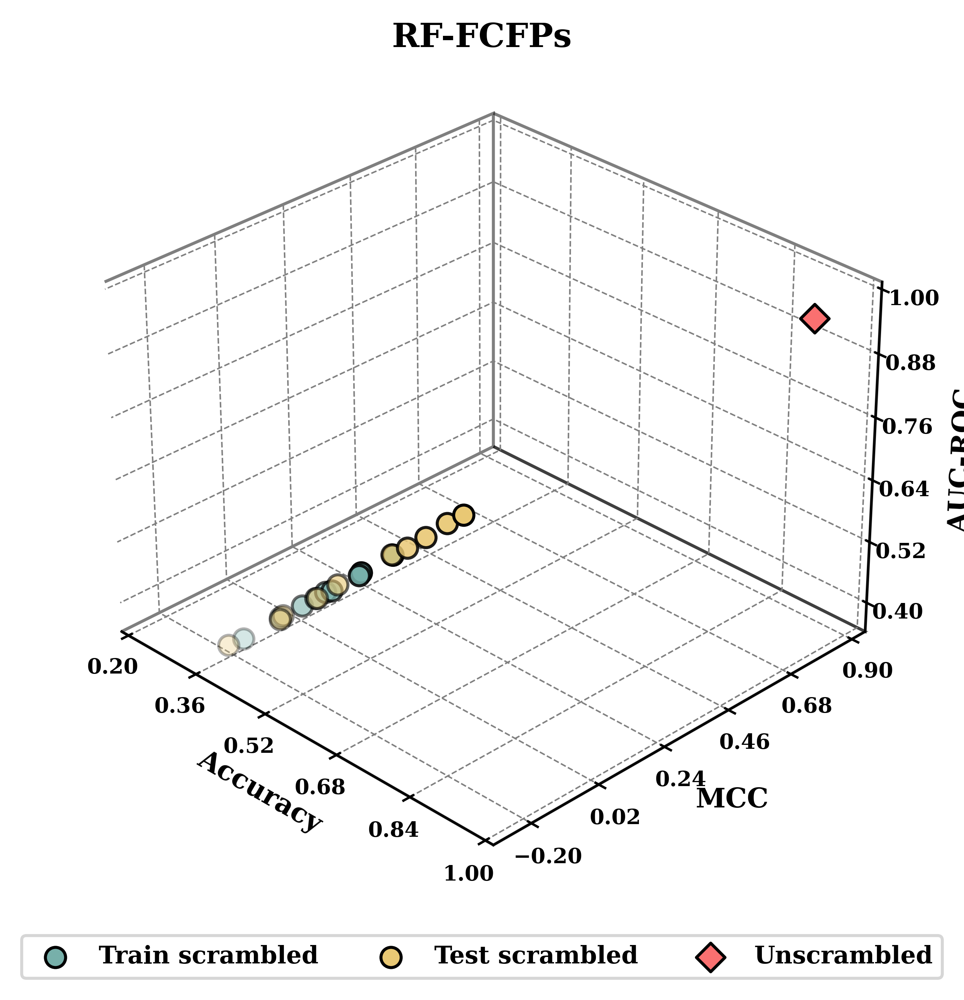

In [38]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./FCFPs-RF/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./FCFPs-RF/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./FCFPs-RF/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('RF-FCFPs', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))   #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))#MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./FCFPs-RF/RF-FCFPs.svg", format='svg', dpi=600)
plt.show()

### FCFPs-LR

In [35]:
from sklearn.linear_model import LogisticRegressionCV
def train_model(X_train, Y_train):
    """Train AdaBoost model with specified parameters."""
    ###########   修改模型
    model = LR = LogisticRegressionCV(random_state=0, n_jobs=-1,
                          solver='sag',
                          penalty='l2',
                          class_weight='balanced',
                          fit_intercept=True,
                          dual=False)
    model.fit(X_train, Y_train)
    return model

def save_results_to_csv(data, filename):
    """Save DataFrame to a CSV file."""
    data.to_csv(filename, index=False)
    print(f"Data saved to {filename}.")
    
#模型扰动
def scramble_and_validate(model, X, Y, dataset_name="train"):
    """Scramble model and validate on specified dataset."""
    #scrambler = Scrambler(model=mlp, iterations=100)
    scrambler = Scrambler(model=model, iterations=100)
    results = scrambler.validate(X, Y, scoring="accuracy", 
                                 cross_val_score_aggregator="mean", 
                                 pvalue_threshold=0.01, 
                                 as_df=True)
    # Save results to CSV file specific to the dataset
    results_filename = f"{dataset_name}_validation_results.csv"
    save_results_to_csv(results, results_filename)
    return results

# 存储原始模型的数据
def process_original_model_results(results, filename):
    original_model_data = results.iloc[0]
    original_model_metrics_df = pd.DataFrame({
        #'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'f1', 'Z-Score', 'P-Value', 'Significance'],
        'Metric': ['Accuracy', 'ROC AUC', 'MCC','P-Value', 'Significance'],
        'Value': [
            original_model_data['accuracy'],
            #original_model_data['recall'],
            #original_model_data['precision'],
            original_model_data['roc_auc'],
            original_model_data['mcc'],
            #original_model_data['f1'],
            #original_model_data['zscore'],
            original_model_data['pvalue'],
            '显著' if original_model_data['significancy'] else '不显著'
        ]
    })
    original_model_metrics_df.to_csv(filename, index=False)
    print(f"Original model metrics saved to {filename}.")
        
#随机提取训练集和测试集10次的扰动结果保存
def save_random_samples(results, dataset_name):
    """Save 10 random non-original model results to CSV."""
    if len(results) > 1:  # 除去原始模型至少还有1条数据
        # 排除第一行（原始模型数据）
        random_indices = np.random.choice(results.index[1:], size=min(10, len(results) - 1), replace=False)
        selected_scrambled_metrics = results.iloc[random_indices]
        filename = f"{dataset_name}_random_scrambled_metrics.csv"
        selected_scrambled_metrics.to_csv(filename, index=False)
        print(f"Random scrambled results saved to {filename}.")
    else:
        print(f"Not enough data to select from in {dataset_name} results.")

############# 读取数据
data = pd.read_csv('./FCFPs/MGAM-train-FCFPs.csv')
data2 = pd.read_csv('./FCFPs/MGAM-test-FCFPs.csv')

# 设置训练集和测试集的特征和标签
X_train = data.iloc[:, 2:]
Y_train = data.iloc[:, 1:2].values.ravel()
X_test = data2.iloc[:, 2:]
Y_test = data2.iloc[:, 1:2].values.ravel()

# 训练模型
model = train_model(X_train, Y_train)

# 验证模型并保存结果
train_results = scramble_and_validate(model, X_train, Y_train, "train")
test_results = scramble_and_validate(model, X_test, Y_test, "test")
    
# 保存原始模型指标
process_original_model_results(train_results, "original_train_model_metrics.csv")
process_original_model_results(test_results, "original_test_model_metrics.csv")

# 使用前面定义的函数来随机选取并保存扰动结果
save_random_samples(train_results, "train")
save_random_samples(test_results, "test")

/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/p

Data saved to train_validation_results.csv.


/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/p

Data saved to test_validation_results.csv.
Original model metrics saved to original_train_model_metrics.csv.
Original model metrics saved to original_test_model_metrics.csv.
Random scrambled results saved to train_random_scrambled_metrics.csv.
Random scrambled results saved to test_random_scrambled_metrics.csv.


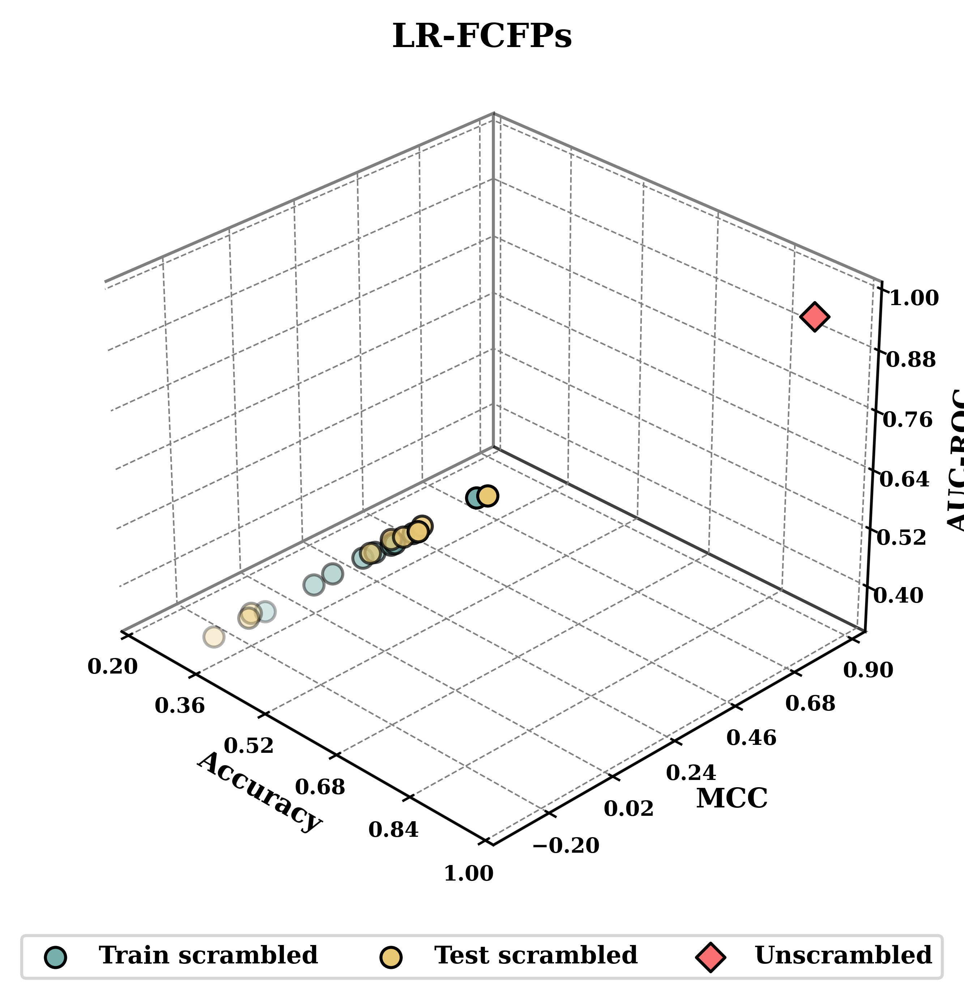

In [36]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./FCFPs-LR/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./FCFPs-LR/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./FCFPs-LR/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('LR-FCFPs', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))   #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))#MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./FCFPs-LR/LR-FCFPs.svg", format='svg', dpi=600)
plt.show()

### FCFPs-XGB

In [39]:
from xgboost import plot_importance
from xgboost.sklearn import XGBClassifier
def train_model(X_train, Y_train):
    """Train model with specified parameters."""
    ###########   修改模型
    model = xgb = XGBClassifier(
    random_state=0,  # 随机种子，保证可复现性
    objective='binary:logistic',  # 目标函数为二元逻辑回归
    colsample_bytree=0.6,  # 构造每棵树时列的采样率
    gamma=0.3,  # 叶子节点分裂所需的最小损失减少
    max_depth=20,  # 最大深度
    min_child_weight=1,  # 孩子节点所需的最小权重和
    n_estimators=60,  # 树的个数
    reg_alpha=0.1,  # L1正则化系数
    reg_lambda=0.1,  # L2正则化系数
    subsample=0.9  # 训练每棵树时样本的采样率
)
    model.fit(X_train, Y_train)
    return model

def save_results_to_csv(data, filename):
    """Save DataFrame to a CSV file."""
    data.to_csv(filename, index=False)
    print(f"Data saved to {filename}.")
    
#模型扰动
def scramble_and_validate(model, X, Y, dataset_name="train"):
    """Scramble model and validate on specified dataset."""
    #scrambler = Scrambler(model=mlp, iterations=100)
    scrambler = Scrambler(model=model, iterations=100)
    results = scrambler.validate(X, Y, scoring="accuracy", 
                                 cross_val_score_aggregator="mean", 
                                 pvalue_threshold=0.01, 
                                 as_df=True)
    # Save results to CSV file specific to the dataset
    results_filename = f"{dataset_name}_validation_results.csv"
    save_results_to_csv(results, results_filename)
    return results

# 存储原始模型的数据
def process_original_model_results(results, filename):
    original_model_data = results.iloc[0]
    original_model_metrics_df = pd.DataFrame({
        #'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'f1', 'Z-Score', 'P-Value', 'Significance'],
        'Metric': ['Accuracy', 'ROC AUC', 'MCC','P-Value', 'Significance'],
        'Value': [
            original_model_data['accuracy'],
            #original_model_data['recall'],
            #original_model_data['precision'],
            original_model_data['roc_auc'],
            original_model_data['mcc'],
            #original_model_data['f1'],
            #original_model_data['zscore'],
            original_model_data['pvalue'],
            '显著' if original_model_data['significancy'] else '不显著'
        ]
    })
    original_model_metrics_df.to_csv(filename, index=False)
    print(f"Original model metrics saved to {filename}.")
        
#随机提取训练集和测试集10次的扰动结果保存
def save_random_samples(results, dataset_name):
    """Save 10 random non-original model results to CSV."""
    if len(results) > 1:  # 除去原始模型至少还有1条数据
        # 排除第一行（原始模型数据）
        random_indices = np.random.choice(results.index[1:], size=min(10, len(results) - 1), replace=False)
        selected_scrambled_metrics = results.iloc[random_indices]
        filename = f"{dataset_name}_random_scrambled_metrics.csv"
        selected_scrambled_metrics.to_csv(filename, index=False)
        print(f"Random scrambled results saved to {filename}.")
    else:
        print(f"Not enough data to select from in {dataset_name} results.")

############# 读取数据
data = pd.read_csv('./FCFPs/MGAM-train-FCFPs.csv')
data2 = pd.read_csv('./FCFPs/MGAM-test-FCFPs.csv')

# 设置训练集和测试集的特征和标签
X_train = data.iloc[:, 2:]
Y_train = data.iloc[:, 1:2].values.ravel()
X_test = data2.iloc[:, 2:]
Y_test = data2.iloc[:, 1:2].values.ravel()

# 训练模型
model = train_model(X_train, Y_train)

# 验证模型并保存结果
train_results = scramble_and_validate(model, X_train, Y_train, "train")
test_results = scramble_and_validate(model, X_test, Y_test, "test")
    
# 保存原始模型指标
process_original_model_results(train_results, "original_train_model_metrics.csv")
process_original_model_results(test_results, "original_test_model_metrics.csv")

# 使用前面定义的函数来随机选取并保存扰动结果
save_random_samples(train_results, "train")
save_random_samples(test_results, "test")

Data saved to train_validation_results.csv.
Data saved to test_validation_results.csv.
Original model metrics saved to original_train_model_metrics.csv.
Original model metrics saved to original_test_model_metrics.csv.
Random scrambled results saved to train_random_scrambled_metrics.csv.
Random scrambled results saved to test_random_scrambled_metrics.csv.


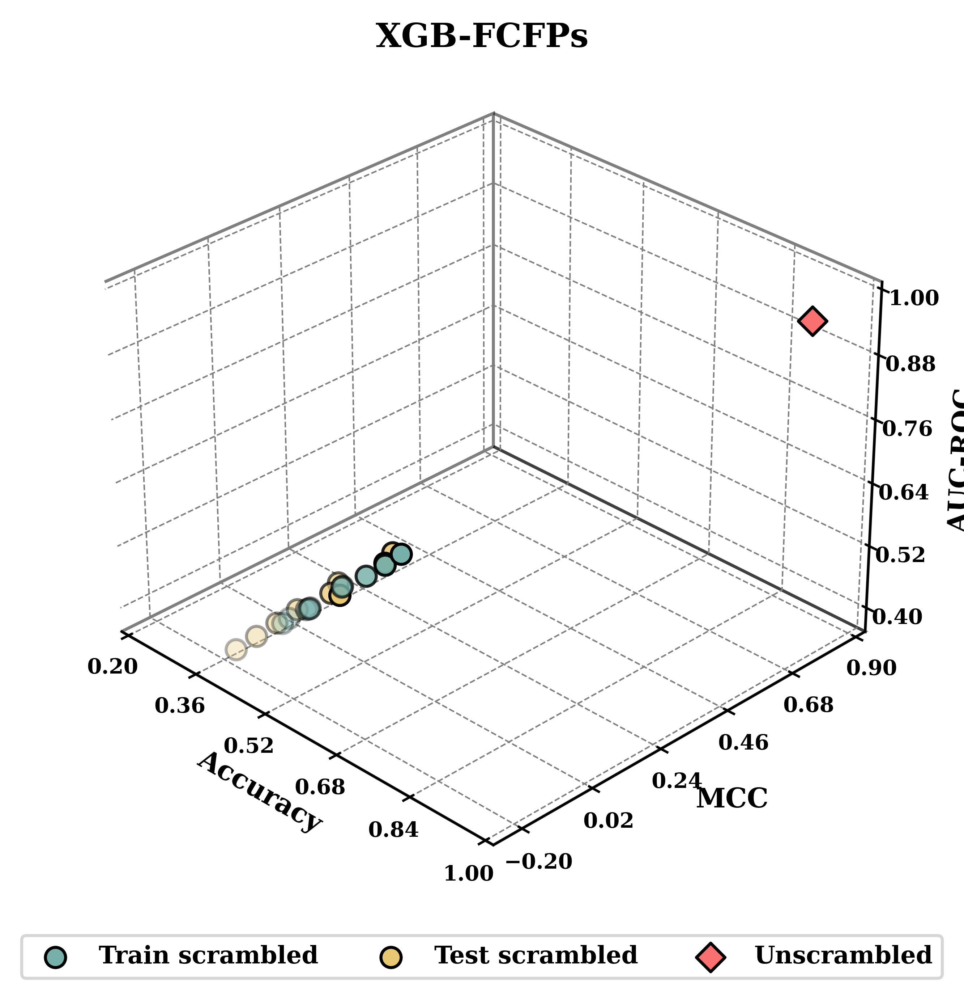

In [40]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./FCFPs-XGB/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./FCFPs-XGB/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./FCFPs-XGB/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('XGB-FCFPs', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./FCFPs-XGB/XGB-FCFPs.svg", format='svg', dpi=600)
plt.show()

### ECFPs-GBT

In [43]:
from sklearn.ensemble import GradientBoostingClassifier
def train_model(X_train, Y_train):
    """Train model with specified parameters."""
    ###########   修改模型
    model = GBT = GradientBoostingClassifier(random_state=0,
                                 criterion='friedman_mse',
                                 max_depth=8,
                                 max_features='sqrt',
                                 min_samples_leaf=3,
                                 min_samples_split=8,
                                 n_estimators=94)
    model.fit(X_train, Y_train)
    return model

def save_results_to_csv(data, filename):
    """Save DataFrame to a CSV file."""
    data.to_csv(filename, index=False)
    print(f"Data saved to {filename}.")
    
#模型扰动
def scramble_and_validate(model, X, Y, dataset_name="train"):
    """Scramble model and validate on specified dataset."""
    #scrambler = Scrambler(model=mlp, iterations=100)
    scrambler = Scrambler(model=model, iterations=100)
    results = scrambler.validate(X, Y, scoring="accuracy", 
                                 cross_val_score_aggregator="mean", 
                                 pvalue_threshold=0.01, 
                                 as_df=True)
    # Save results to CSV file specific to the dataset
    results_filename = f"{dataset_name}_validation_results.csv"
    save_results_to_csv(results, results_filename)
    return results

# 存储原始模型的数据
def process_original_model_results(results, filename):
    original_model_data = results.iloc[0]
    original_model_metrics_df = pd.DataFrame({
        #'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'f1', 'Z-Score', 'P-Value', 'Significance'],
        'Metric': ['Accuracy', 'ROC AUC', 'MCC','P-Value', 'Significance'],
        'Value': [
            original_model_data['accuracy'],
            #original_model_data['recall'],
            #original_model_data['precision'],
            original_model_data['roc_auc'],
            original_model_data['mcc'],
            #original_model_data['f1'],
            #original_model_data['zscore'],
            original_model_data['pvalue'],
            '显著' if original_model_data['significancy'] else '不显著'
        ]
    })
    original_model_metrics_df.to_csv(filename, index=False)
    print(f"Original model metrics saved to {filename}.")
        
#随机提取训练集和测试集10次的扰动结果保存
def save_random_samples(results, dataset_name):
    """Save 10 random non-original model results to CSV."""
    if len(results) > 1:  # 除去原始模型至少还有1条数据
        # 排除第一行（原始模型数据）
        random_indices = np.random.choice(results.index[1:], size=min(10, len(results) - 1), replace=False)
        selected_scrambled_metrics = results.iloc[random_indices]
        filename = f"{dataset_name}_random_scrambled_metrics.csv"
        selected_scrambled_metrics.to_csv(filename, index=False)
        print(f"Random scrambled results saved to {filename}.")
    else:
        print(f"Not enough data to select from in {dataset_name} results.")

############# 读取数据
data = pd.read_csv('./ECFPs/MGAM-train-ECFP4.csv')
data2 = pd.read_csv('./ECFPs/MGAM-test-ECFP4.csv')

# 设置训练集和测试集的特征和标签
X_train = data.iloc[:, 2:]
Y_train = data.iloc[:, 1:2].values.ravel()
X_test = data2.iloc[:, 2:]
Y_test = data2.iloc[:, 1:2].values.ravel()

# 训练模型
model = train_model(X_train, Y_train)

# 验证模型并保存结果
train_results = scramble_and_validate(model, X_train, Y_train, "train")
test_results = scramble_and_validate(model, X_test, Y_test, "test")
    
# 保存原始模型指标
process_original_model_results(train_results, "original_train_model_metrics.csv")
process_original_model_results(test_results, "original_test_model_metrics.csv")

# 使用前面定义的函数来随机选取并保存扰动结果
save_random_samples(train_results, "train")
save_random_samples(test_results, "test")

Data saved to train_validation_results.csv.
Data saved to test_validation_results.csv.
Original model metrics saved to original_train_model_metrics.csv.
Original model metrics saved to original_test_model_metrics.csv.
Random scrambled results saved to train_random_scrambled_metrics.csv.
Random scrambled results saved to test_random_scrambled_metrics.csv.


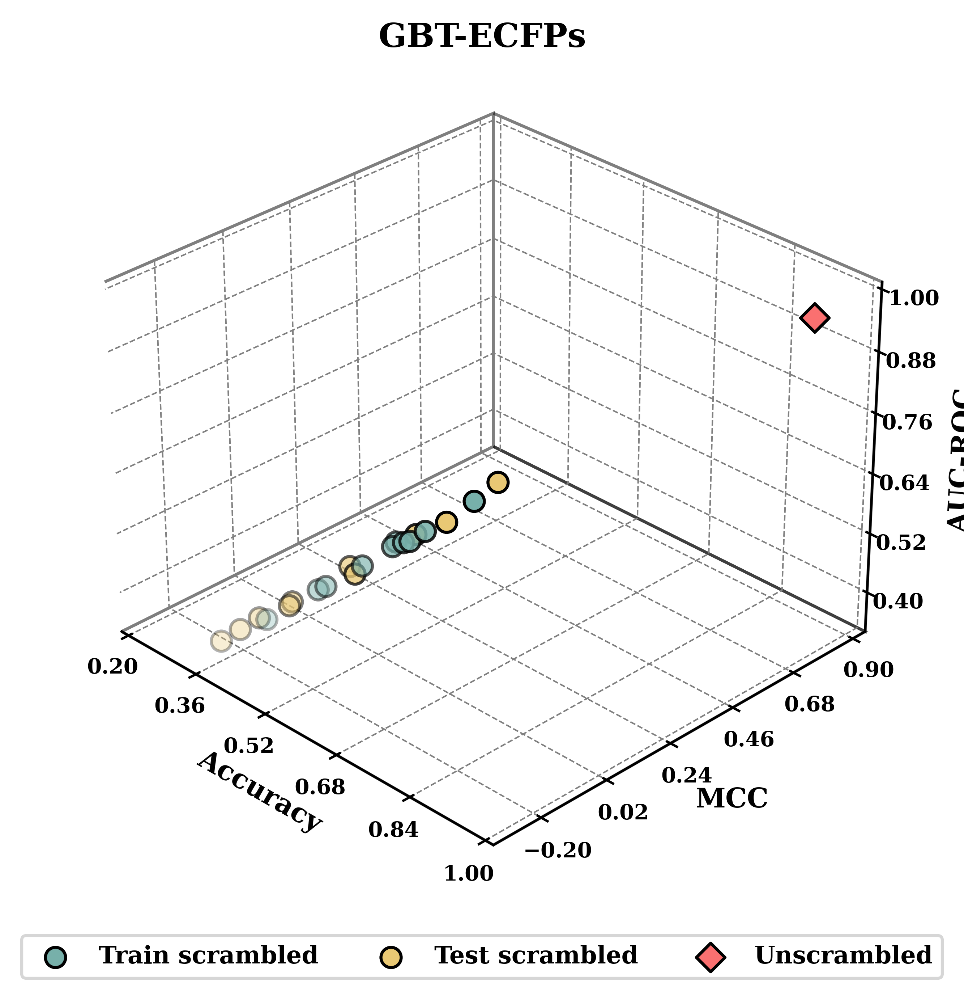

In [45]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./ECFPs-GBT/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./ECFPs-GBT/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./ECFPs-GBT/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('GBT-ECFPs', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./ECFPs-GBT/GBT-ECFPs.svg", format='svg', dpi=600)
plt.show()

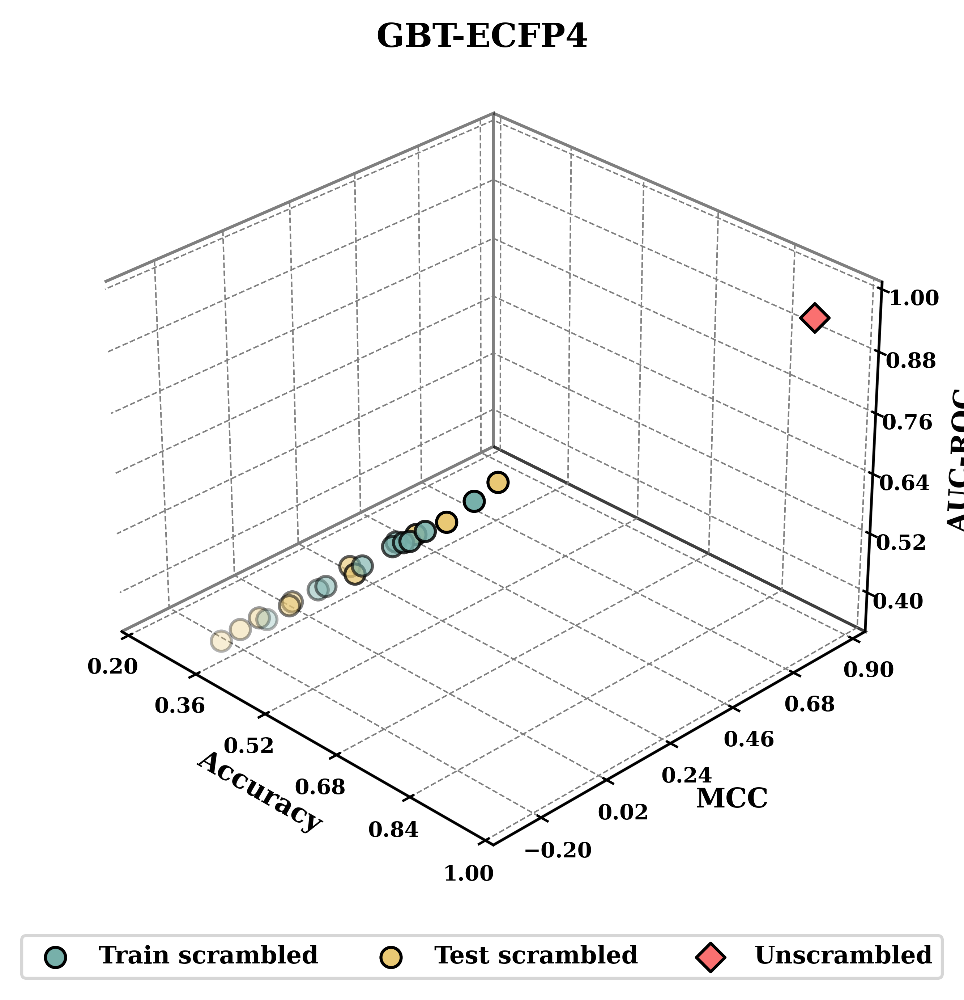

In [46]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./ECFPs-GBT/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./ECFPs-GBT/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./ECFPs-GBT/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('GBT-ECFP4', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./ECFPs-GBT/GBT-ECFP4.svg", format='svg', dpi=600)
plt.show()

### ECFPs-RF

In [47]:
from sklearn.ensemble import RandomForestClassifier
def train_model(X_train, Y_train):
    """Train model with specified parameters."""
    ###########   修改模型
    model = RF = RandomForestClassifier(
    random_state=0,  # 设置随机种子，确保结果可重复
    class_weight='balanced',  # 类别权重，处理不平衡数据集
    criterion='entropy',  # 评价分裂质量的标准，这里使用基尼不纯度
    max_features='sqrt',  # 寻找最佳分裂时考虑的特征数，这里使用log2
    bootstrap=True,  # 是否使用bootstrap样本
    max_depth=25,  # 树的最大深度
    min_samples_leaf=3,  # 叶节点最少样本数
    min_samples_split=9,  # 分裂内部节点所需的最小样本数
    n_estimators=98,  # 构建的树的数量
    oob_score=True  # 是否使用袋外样本来评估精度
)
    model.fit(X_train, Y_train)
    return model

def save_results_to_csv(data, filename):
    """Save DataFrame to a CSV file."""
    data.to_csv(filename, index=False)
    print(f"Data saved to {filename}.")
    
#模型扰动
def scramble_and_validate(model, X, Y, dataset_name="train"):
    """Scramble model and validate on specified dataset."""
    #scrambler = Scrambler(model=mlp, iterations=100)
    scrambler = Scrambler(model=model, iterations=100)
    results = scrambler.validate(X, Y, scoring="accuracy", 
                                 cross_val_score_aggregator="mean", 
                                 pvalue_threshold=0.01, 
                                 as_df=True)
    # Save results to CSV file specific to the dataset
    results_filename = f"{dataset_name}_validation_results.csv"
    save_results_to_csv(results, results_filename)
    return results

# 存储原始模型的数据
def process_original_model_results(results, filename):
    original_model_data = results.iloc[0]
    original_model_metrics_df = pd.DataFrame({
        #'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'f1', 'Z-Score', 'P-Value', 'Significance'],
        'Metric': ['Accuracy', 'ROC AUC', 'MCC','P-Value', 'Significance'],
        'Value': [
            original_model_data['accuracy'],
            #original_model_data['recall'],
            #original_model_data['precision'],
            original_model_data['roc_auc'],
            original_model_data['mcc'],
            #original_model_data['f1'],
            #original_model_data['zscore'],
            original_model_data['pvalue'],
            '显著' if original_model_data['significancy'] else '不显著'
        ]
    })
    original_model_metrics_df.to_csv(filename, index=False)
    print(f"Original model metrics saved to {filename}.")
        
#随机提取训练集和测试集10次的扰动结果保存
def save_random_samples(results, dataset_name):
    """Save 10 random non-original model results to CSV."""
    if len(results) > 1:  # 除去原始模型至少还有1条数据
        # 排除第一行（原始模型数据）
        random_indices = np.random.choice(results.index[1:], size=min(10, len(results) - 1), replace=False)
        selected_scrambled_metrics = results.iloc[random_indices]
        filename = f"{dataset_name}_random_scrambled_metrics.csv"
        selected_scrambled_metrics.to_csv(filename, index=False)
        print(f"Random scrambled results saved to {filename}.")
    else:
        print(f"Not enough data to select from in {dataset_name} results.")

############# 读取数据
data = pd.read_csv('./ECFPs/MGAM-train-ECFP4.csv')
data2 = pd.read_csv('./ECFPs/MGAM-test-ECFP4.csv')

# 设置训练集和测试集的特征和标签
X_train = data.iloc[:, 2:]
Y_train = data.iloc[:, 1:2].values.ravel()
X_test = data2.iloc[:, 2:]
Y_test = data2.iloc[:, 1:2].values.ravel()

# 训练模型
model = train_model(X_train, Y_train)

# 验证模型并保存结果
train_results = scramble_and_validate(model, X_train, Y_train, "train")
test_results = scramble_and_validate(model, X_test, Y_test, "test")
    
# 保存原始模型指标
process_original_model_results(train_results, "original_train_model_metrics.csv")
process_original_model_results(test_results, "original_test_model_metrics.csv")

# 使用前面定义的函数来随机选取并保存扰动结果
save_random_samples(train_results, "train")
save_random_samples(test_results, "test")

Data saved to train_validation_results.csv.
Data saved to test_validation_results.csv.
Original model metrics saved to original_train_model_metrics.csv.
Original model metrics saved to original_test_model_metrics.csv.
Random scrambled results saved to train_random_scrambled_metrics.csv.
Random scrambled results saved to test_random_scrambled_metrics.csv.


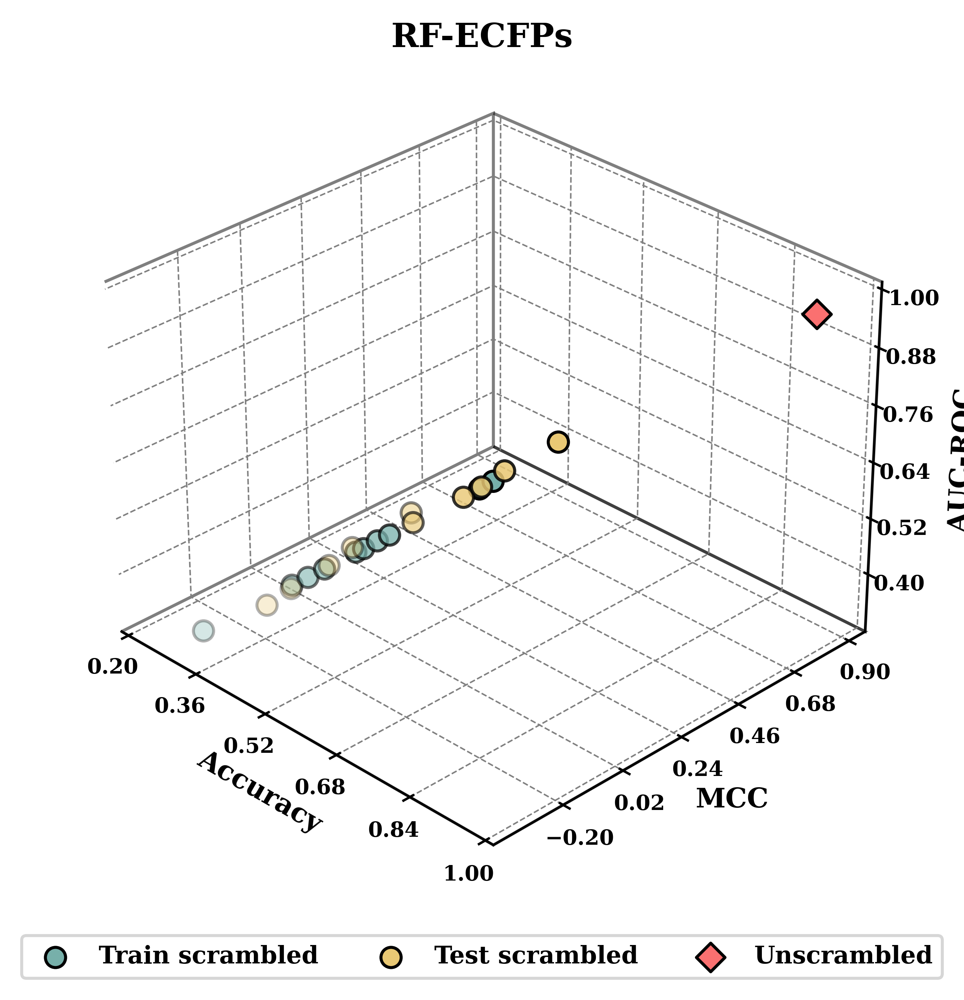

In [48]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./ECFPs-RF/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./ECFPs-RF/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./ECFPs-RF/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('RF-ECFPs', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./ECFPs-RF/RF-ECFPs.svg", format='svg', dpi=600)
plt.show()

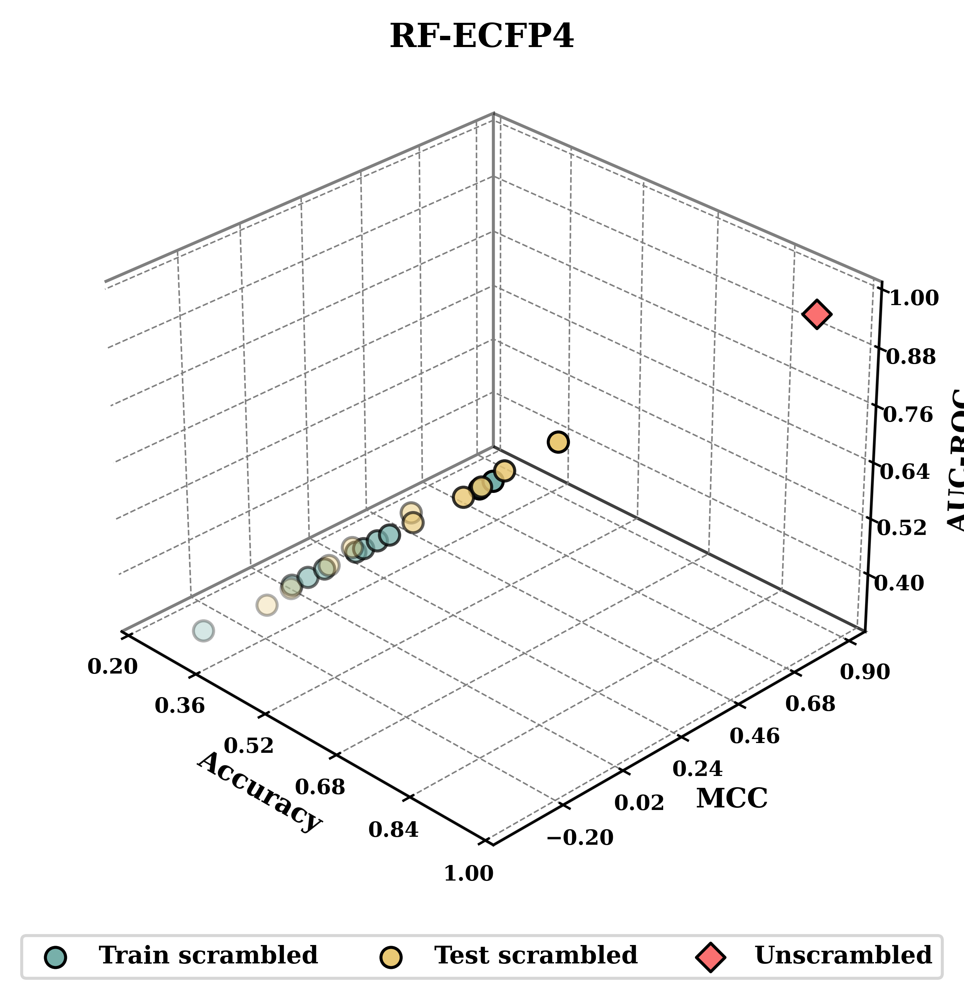

In [49]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./ECFPs-RF/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./ECFPs-RF/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./ECFPs-RF/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('RF-ECFP4', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./ECFPs-RF/RF-ECFP4.svg", format='svg', dpi=600)
plt.show()

### ECFPs-XGB

In [50]:
from xgboost import plot_importance
from xgboost.sklearn import XGBClassifier
def train_model(X_train, Y_train):
    """Train model with specified parameters."""
    ###########   修改模型
    model = XGB = XGBClassifier(
    random_state=0,  # 随机种子，保证可复现性
    objective='binary:logistic',  # 目标函数为二元逻辑回归
    colsample_bytree=0.7,  # 构造每棵树时列的采样率
    gamma=0.1,  # 叶子节点分裂所需的最小损失减少
    max_depth=7,  # 最大深度
    min_child_weight=1,  # 孩子节点所需的最小权重和
    n_estimators=30,  # 树的个数
    reg_alpha=0.1,  # L1正则化系数
    reg_lambda=0.1,  # L2正则化系数
    subsample=0.9  # 训练每棵树时样本的采样率
)
    model.fit(X_train, Y_train)
    return model

def save_results_to_csv(data, filename):
    """Save DataFrame to a CSV file."""
    data.to_csv(filename, index=False)
    print(f"Data saved to {filename}.")
    
#模型扰动
def scramble_and_validate(model, X, Y, dataset_name="train"):
    """Scramble model and validate on specified dataset."""
    #scrambler = Scrambler(model=mlp, iterations=100)
    scrambler = Scrambler(model=model, iterations=100)
    results = scrambler.validate(X, Y, scoring="accuracy", 
                                 cross_val_score_aggregator="mean", 
                                 pvalue_threshold=0.01, 
                                 as_df=True)
    # Save results to CSV file specific to the dataset
    results_filename = f"{dataset_name}_validation_results.csv"
    save_results_to_csv(results, results_filename)
    return results

# 存储原始模型的数据
def process_original_model_results(results, filename):
    original_model_data = results.iloc[0]
    original_model_metrics_df = pd.DataFrame({
        #'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'f1', 'Z-Score', 'P-Value', 'Significance'],
        'Metric': ['Accuracy', 'ROC AUC', 'MCC','P-Value', 'Significance'],
        'Value': [
            original_model_data['accuracy'],
            #original_model_data['recall'],
            #original_model_data['precision'],
            original_model_data['roc_auc'],
            original_model_data['mcc'],
            #original_model_data['f1'],
            #original_model_data['zscore'],
            original_model_data['pvalue'],
            '显著' if original_model_data['significancy'] else '不显著'
        ]
    })
    original_model_metrics_df.to_csv(filename, index=False)
    print(f"Original model metrics saved to {filename}.")
        
#随机提取训练集和测试集10次的扰动结果保存
def save_random_samples(results, dataset_name):
    """Save 10 random non-original model results to CSV."""
    if len(results) > 1:  # 除去原始模型至少还有1条数据
        # 排除第一行（原始模型数据）
        random_indices = np.random.choice(results.index[1:], size=min(10, len(results) - 1), replace=False)
        selected_scrambled_metrics = results.iloc[random_indices]
        filename = f"{dataset_name}_random_scrambled_metrics.csv"
        selected_scrambled_metrics.to_csv(filename, index=False)
        print(f"Random scrambled results saved to {filename}.")
    else:
        print(f"Not enough data to select from in {dataset_name} results.")

############# 读取数据
data = pd.read_csv('./ECFPs/MGAM-train-ECFP4.csv')
data2 = pd.read_csv('./ECFPs/MGAM-test-ECFP4.csv')

# 设置训练集和测试集的特征和标签
X_train = data.iloc[:, 2:]
Y_train = data.iloc[:, 1:2].values.ravel()
X_test = data2.iloc[:, 2:]
Y_test = data2.iloc[:, 1:2].values.ravel()

# 训练模型
model = train_model(X_train, Y_train)

# 验证模型并保存结果
train_results = scramble_and_validate(model, X_train, Y_train, "train")
test_results = scramble_and_validate(model, X_test, Y_test, "test")
    
# 保存原始模型指标
process_original_model_results(train_results, "original_train_model_metrics.csv")
process_original_model_results(test_results, "original_test_model_metrics.csv")

# 使用前面定义的函数来随机选取并保存扰动结果
save_random_samples(train_results, "train")
save_random_samples(test_results, "test")

Data saved to train_validation_results.csv.
Data saved to test_validation_results.csv.
Original model metrics saved to original_train_model_metrics.csv.
Original model metrics saved to original_test_model_metrics.csv.
Random scrambled results saved to train_random_scrambled_metrics.csv.
Random scrambled results saved to test_random_scrambled_metrics.csv.


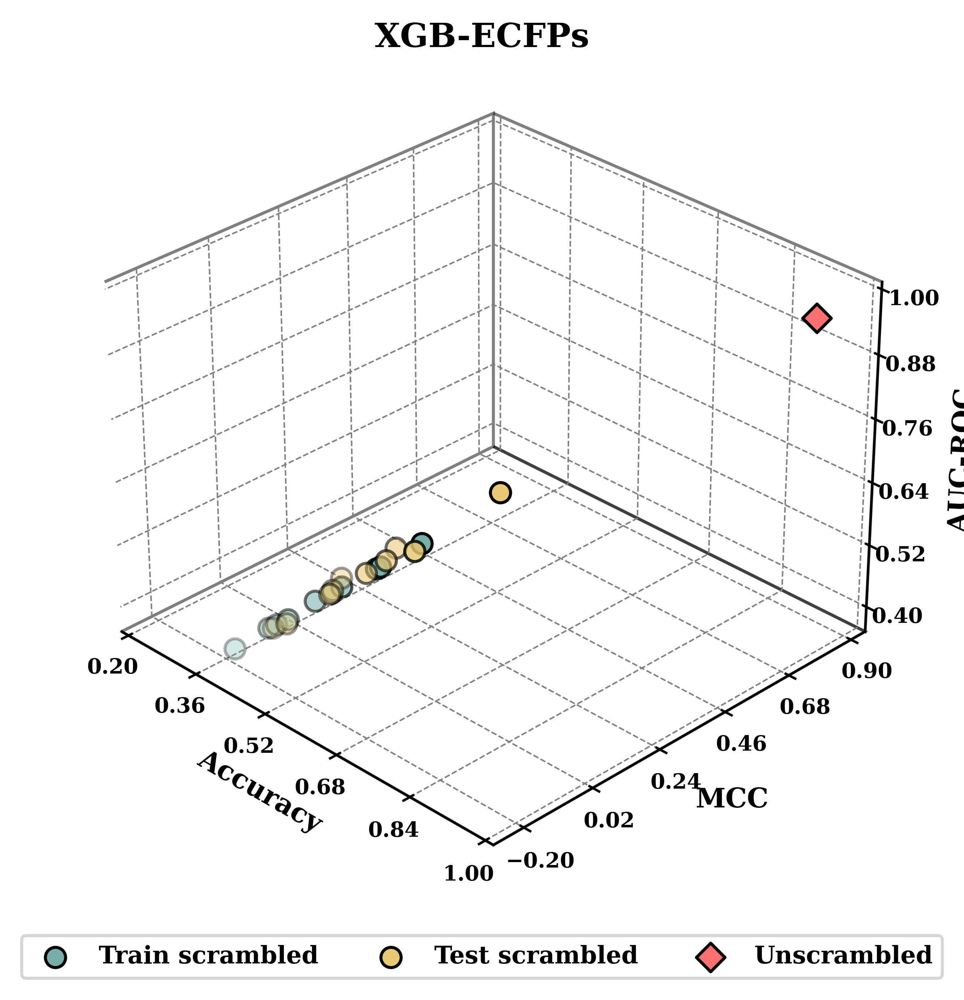

In [51]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./ECFPs-XGB/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./ECFPs-XGB/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./ECFPs-XGB/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('XGB-ECFPs', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./ECFPs-XGB/XGB-ECFPs.svg", format='svg', dpi=600)
plt.show()

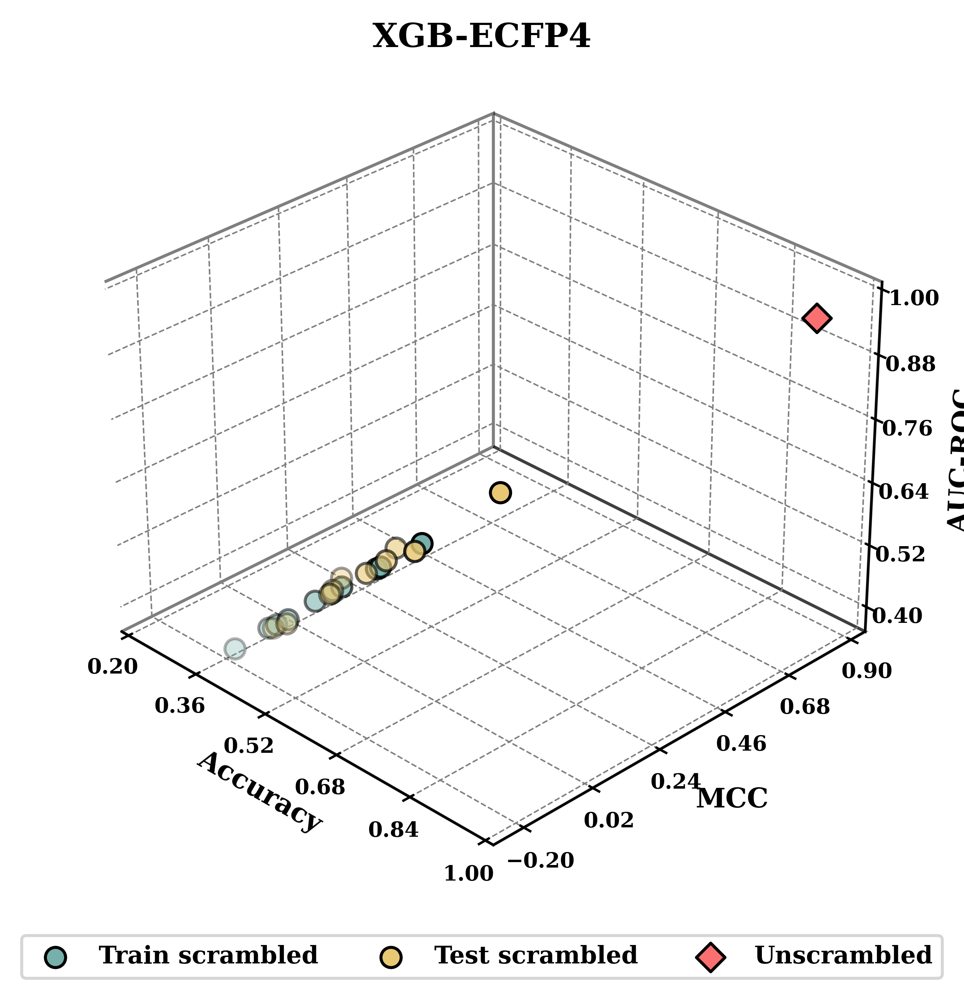

In [52]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./ECFPs-XGB/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./ECFPs-XGB/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./ECFPs-XGB/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('XGB-ECFP4', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./ECFPs-XGB/XGB-ECFP4.svg", format='svg', dpi=600)
plt.show()

### AvalonFPs-DNN

In [53]:
from sklearn.neural_network import MLPClassifier
def train_model(X_train, Y_train):
    """Train model with specified parameters."""
    ###########   修改模型
    model = mlp = MLPClassifier(
    random_state=0,
    activation='relu',
    hidden_layer_sizes = (200, 155, 155),
    learning_rate = 'constant',
    solver = 'sgd')
    model.fit(X_train, Y_train)
    return model

def save_results_to_csv(data, filename):
    """Save DataFrame to a CSV file."""
    data.to_csv(filename, index=False)
    print(f"Data saved to {filename}.")
    
#模型扰动
def scramble_and_validate(model, X, Y, dataset_name="train"):
    """Scramble model and validate on specified dataset."""
    #scrambler = Scrambler(model=mlp, iterations=100)
    scrambler = Scrambler(model=model, iterations=100)
    results = scrambler.validate(X, Y, scoring="accuracy", 
                                 cross_val_score_aggregator="mean", 
                                 pvalue_threshold=0.01, 
                                 as_df=True)
    # Save results to CSV file specific to the dataset
    results_filename = f"{dataset_name}_validation_results.csv"
    save_results_to_csv(results, results_filename)
    return results

# 存储原始模型的数据
def process_original_model_results(results, filename):
    original_model_data = results.iloc[0]
    original_model_metrics_df = pd.DataFrame({
        #'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'f1', 'Z-Score', 'P-Value', 'Significance'],
        'Metric': ['Accuracy', 'ROC AUC', 'MCC','P-Value', 'Significance'],
        'Value': [
            original_model_data['accuracy'],
            #original_model_data['recall'],
            #original_model_data['precision'],
            original_model_data['roc_auc'],
            original_model_data['mcc'],
            #original_model_data['f1'],
            #original_model_data['zscore'],
            original_model_data['pvalue'],
            '显著' if original_model_data['significancy'] else '不显著'
        ]
    })
    original_model_metrics_df.to_csv(filename, index=False)
    print(f"Original model metrics saved to {filename}.")
        
#随机提取训练集和测试集10次的扰动结果保存
def save_random_samples(results, dataset_name):
    """Save 10 random non-original model results to CSV."""
    if len(results) > 1:  # 除去原始模型至少还有1条数据
        # 排除第一行（原始模型数据）
        random_indices = np.random.choice(results.index[1:], size=min(10, len(results) - 1), replace=False)
        selected_scrambled_metrics = results.iloc[random_indices]
        filename = f"{dataset_name}_random_scrambled_metrics.csv"
        selected_scrambled_metrics.to_csv(filename, index=False)
        print(f"Random scrambled results saved to {filename}.")
    else:
        print(f"Not enough data to select from in {dataset_name} results.")

############# 读取数据
data = pd.read_csv('./AvalonFPs/MGAM-train-Avalonfps.csv')
data2 = pd.read_csv('./AvalonFPs/MGAM-test-Avalonfps.csv')

# 设置训练集和测试集的特征和标签
X_train = data.iloc[:, 2:]
Y_train = data.iloc[:, 1:2].values.ravel()
X_test = data2.iloc[:, 2:]
Y_test = data2.iloc[:, 1:2].values.ravel()

# 训练模型
model = train_model(X_train, Y_train)

# 验证模型并保存结果
train_results = scramble_and_validate(model, X_train, Y_train, "train")
test_results = scramble_and_validate(model, X_test, Y_test, "test")
    
# 保存原始模型指标
process_original_model_results(train_results, "original_train_model_metrics.csv")
process_original_model_results(test_results, "original_test_model_metrics.csv")

# 使用前面定义的函数来随机选取并保存扰动结果
save_random_samples(train_results, "train")
save_random_samples(test_results, "test")

/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/md04/a

Data saved to train_validation_results.csv.


/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/md04/a

Data saved to test_validation_results.csv.
Original model metrics saved to original_train_model_metrics.csv.
Original model metrics saved to original_test_model_metrics.csv.
Random scrambled results saved to train_random_scrambled_metrics.csv.
Random scrambled results saved to test_random_scrambled_metrics.csv.


/home/md04/anaconda3/envs/fbw/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


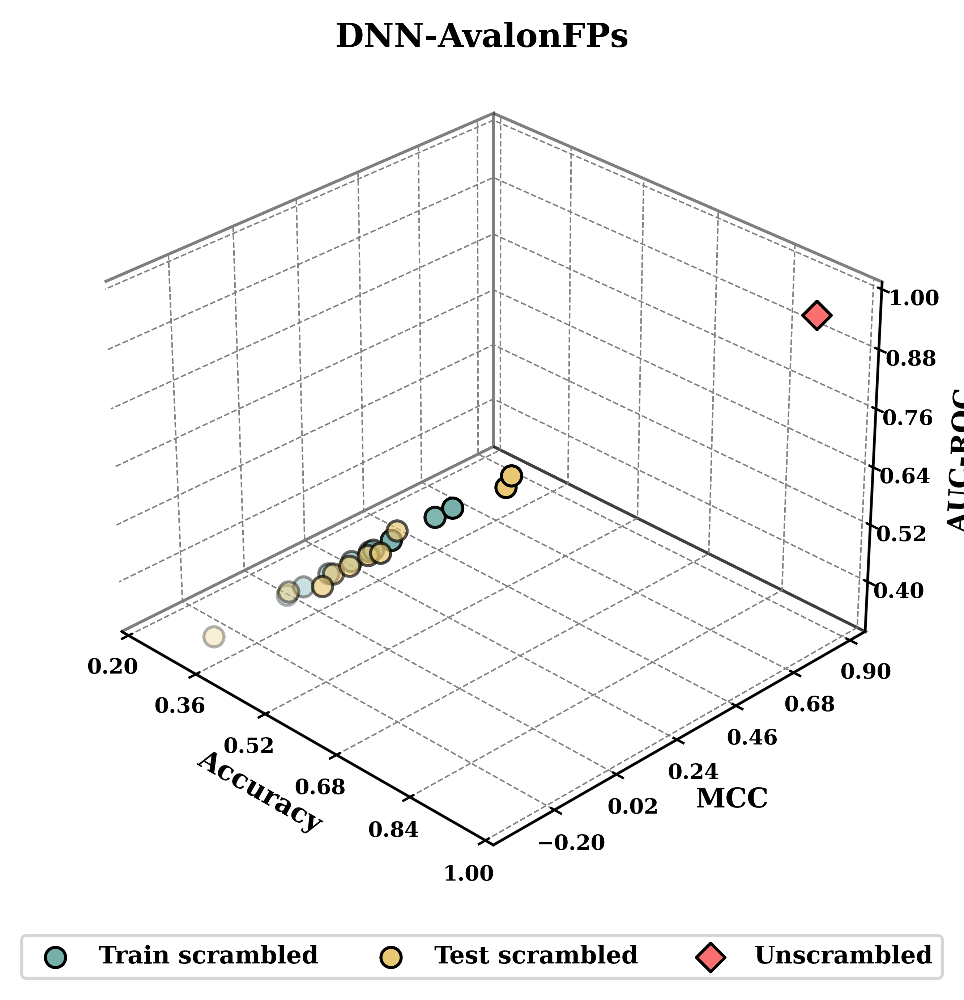

In [54]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./AvalonFPs-DNN/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./AvalonFPs-DNN/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./AvalonFPs-DNN/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('DNN-AvalonFPs', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./AvalonFPs-DNN/DNN-AvalonFPs.svg", format='svg', dpi=600)
plt.show()

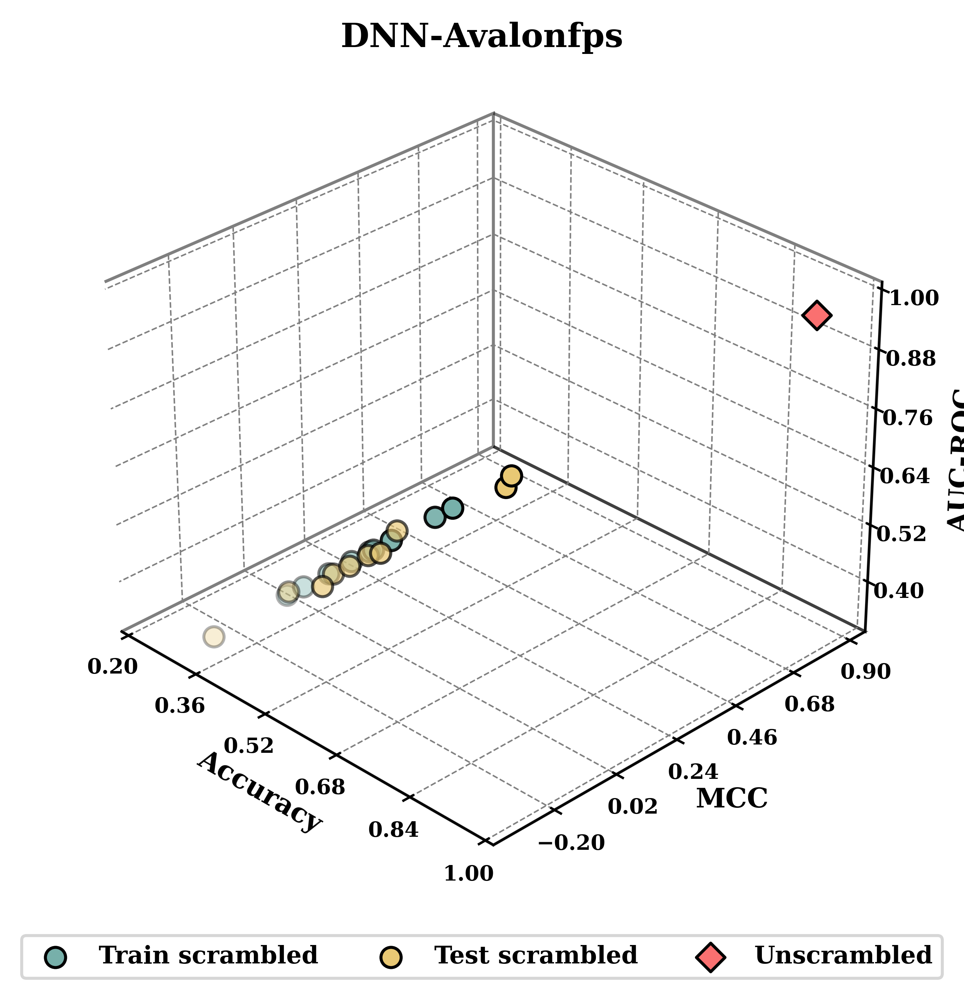

In [55]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./AvalonFPs-DNN/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./AvalonFPs-DNN/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./AvalonFPs-DNN/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('DNN-Avalonfps', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./AvalonFPs-DNN/DNN-Avalonfps.svg", format='svg', dpi=600)
plt.show()

### AvalonFPs-RF

In [56]:
from sklearn.ensemble import RandomForestClassifier
def train_model(X_train, Y_train):
    """Train model with specified parameters."""
    ###########   修改模型
    model = RF = RandomForestClassifier(
    random_state=0,  # 设置随机种子，确保结果可重复
    class_weight='balanced',  # 类别权重，处理不平衡数据集
    criterion='entropy',  # 评价分裂质量的标准，这里使用基尼不纯度
    max_features='sqrt',  # 寻找最佳分裂时考虑的特征数，这里使用log2
    bootstrap=True,  # 是否使用bootstrap样本
    max_depth=9,  # 树的最大深度
    min_samples_leaf=3,  # 叶节点最少样本数
    min_samples_split=7,  # 分裂内部节点所需的最小样本数
    n_estimators=143,  # 构建的树的数量
    oob_score=True  # 是否使用袋外样本来评估精度
)
    model.fit(X_train, Y_train)
    return model

def save_results_to_csv(data, filename):
    """Save DataFrame to a CSV file."""
    data.to_csv(filename, index=False)
    print(f"Data saved to {filename}.")
    
#模型扰动
def scramble_and_validate(model, X, Y, dataset_name="train"):
    """Scramble model and validate on specified dataset."""
    #scrambler = Scrambler(model=mlp, iterations=100)
    scrambler = Scrambler(model=model, iterations=100)
    results = scrambler.validate(X, Y, scoring="accuracy", 
                                 cross_val_score_aggregator="mean", 
                                 pvalue_threshold=0.01, 
                                 as_df=True)
    # Save results to CSV file specific to the dataset
    results_filename = f"{dataset_name}_validation_results.csv"
    save_results_to_csv(results, results_filename)
    return results

# 存储原始模型的数据
def process_original_model_results(results, filename):
    original_model_data = results.iloc[0]
    original_model_metrics_df = pd.DataFrame({
        #'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'f1', 'Z-Score', 'P-Value', 'Significance'],
        'Metric': ['Accuracy', 'ROC AUC', 'MCC','P-Value', 'Significance'],
        'Value': [
            original_model_data['accuracy'],
            #original_model_data['recall'],
            #original_model_data['precision'],
            original_model_data['roc_auc'],
            original_model_data['mcc'],
            #original_model_data['f1'],
            #original_model_data['zscore'],
            original_model_data['pvalue'],
            '显著' if original_model_data['significancy'] else '不显著'
        ]
    })
    original_model_metrics_df.to_csv(filename, index=False)
    print(f"Original model metrics saved to {filename}.")
        
#随机提取训练集和测试集10次的扰动结果保存
def save_random_samples(results, dataset_name):
    """Save 10 random non-original model results to CSV."""
    if len(results) > 1:  # 除去原始模型至少还有1条数据
        # 排除第一行（原始模型数据）
        random_indices = np.random.choice(results.index[1:], size=min(10, len(results) - 1), replace=False)
        selected_scrambled_metrics = results.iloc[random_indices]
        filename = f"{dataset_name}_random_scrambled_metrics.csv"
        selected_scrambled_metrics.to_csv(filename, index=False)
        print(f"Random scrambled results saved to {filename}.")
    else:
        print(f"Not enough data to select from in {dataset_name} results.")

############# 读取数据
data = pd.read_csv('./AvalonFPs/MGAM-train-Avalonfps.csv')
data2 = pd.read_csv('./AvalonFPs/MGAM-test-Avalonfps.csv')

# 设置训练集和测试集的特征和标签
X_train = data.iloc[:, 2:]
Y_train = data.iloc[:, 1:2].values.ravel()
X_test = data2.iloc[:, 2:]
Y_test = data2.iloc[:, 1:2].values.ravel()

# 训练模型
model = train_model(X_train, Y_train)

# 验证模型并保存结果
train_results = scramble_and_validate(model, X_train, Y_train, "train")
test_results = scramble_and_validate(model, X_test, Y_test, "test")
    
# 保存原始模型指标
process_original_model_results(train_results, "original_train_model_metrics.csv")
process_original_model_results(test_results, "original_test_model_metrics.csv")

# 使用前面定义的函数来随机选取并保存扰动结果
save_random_samples(train_results, "train")
save_random_samples(test_results, "test")

Data saved to train_validation_results.csv.
Data saved to test_validation_results.csv.
Original model metrics saved to original_train_model_metrics.csv.
Original model metrics saved to original_test_model_metrics.csv.
Random scrambled results saved to train_random_scrambled_metrics.csv.
Random scrambled results saved to test_random_scrambled_metrics.csv.


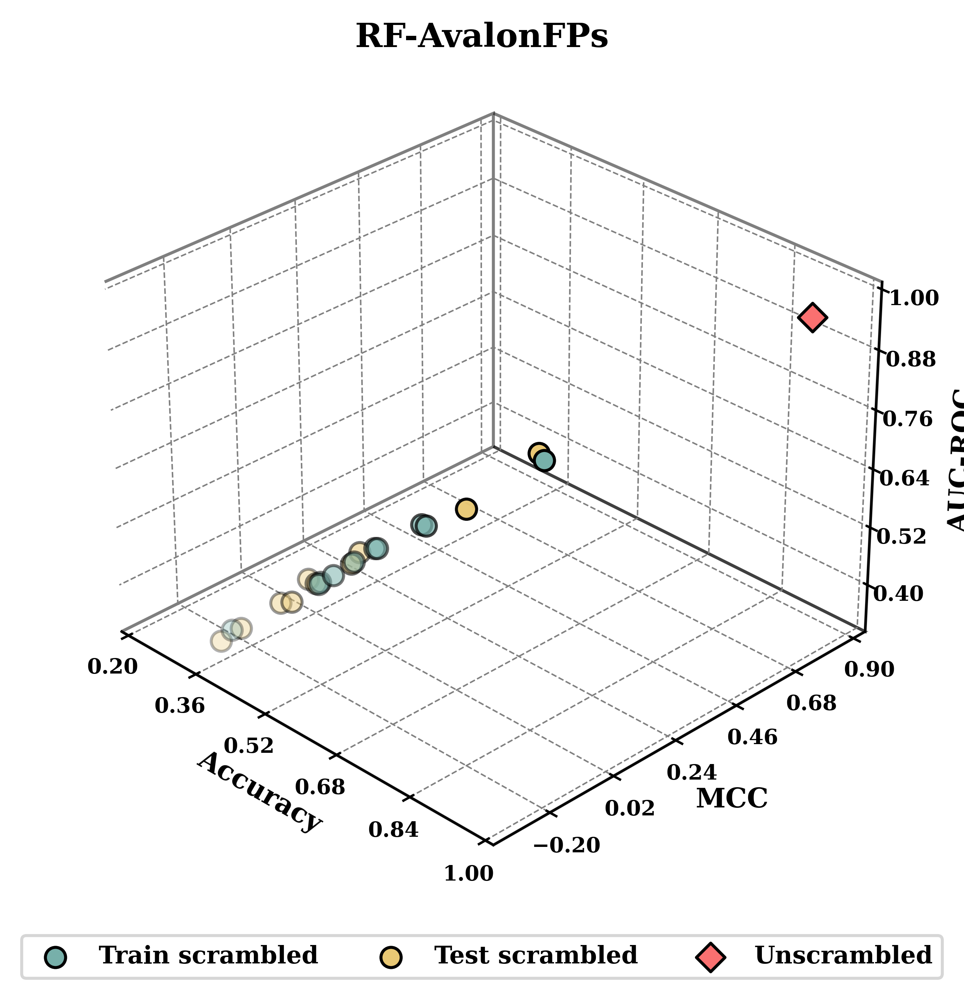

In [57]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./AvalonFPs-RF/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./AvalonFPs-RF/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./AvalonFPs-RF/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('RF-AvalonFPs', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./AvalonFPs-RF/RF-AvalonFPs.svg", format='svg', dpi=600)
plt.show()

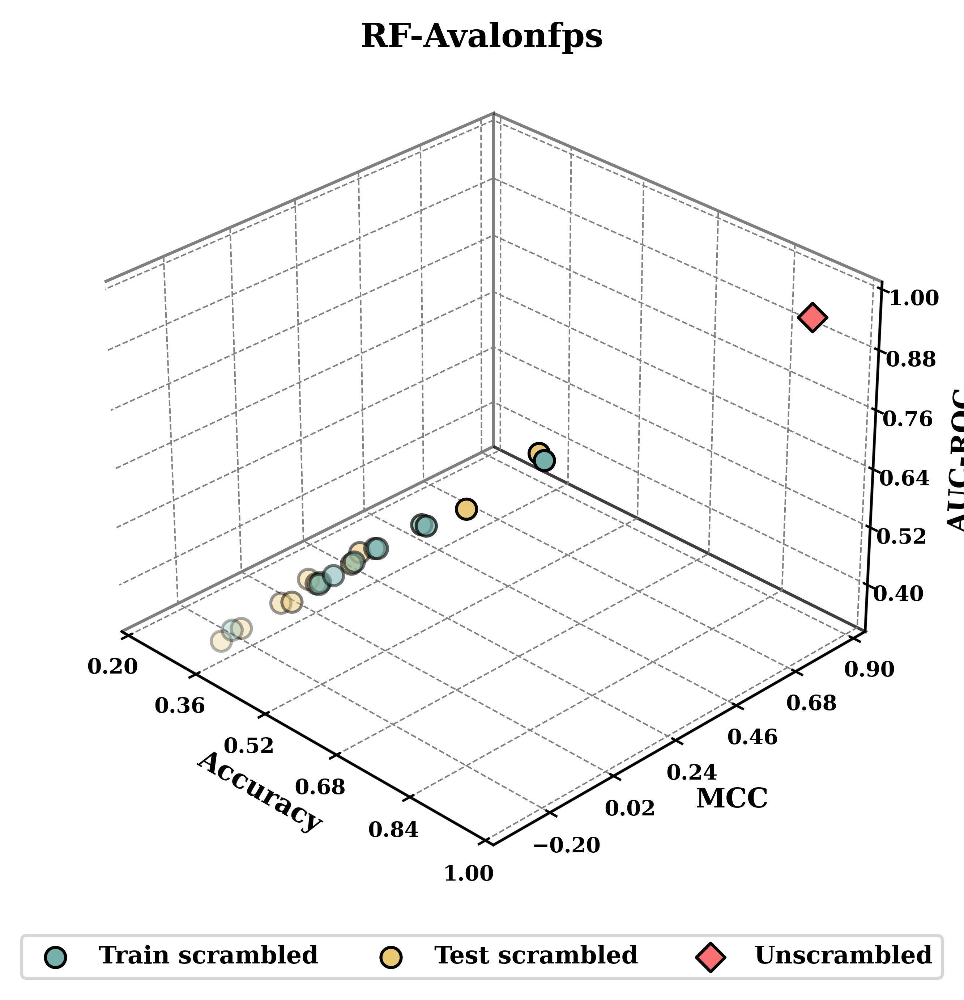

In [58]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./AvalonFPs-RF/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./AvalonFPs-RF/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./AvalonFPs-RF/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('RF-Avalonfps', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./AvalonFPs-RF/RF-Avalonfps.svg", format='svg', dpi=600)
plt.show()

### AvalonFPs-SVM

In [59]:
from sklearn.svm import SVC
def train_model(X_train, Y_train):
    """Train model with specified parameters."""
    ###########   修改模型
    model = SVM = SVC(random_state=0,        # 随机数种子
          class_weight='balanced',  # 类别权重平衡
          gamma='auto',             # 核函数的系数
          C=100,                     # 正则化参数
          kernel='poly',         # 使用sigmoid核
          shrinking=True,           # 是否使用shrinking heuristic方法
          probability=True)         # 是否启用概率估计
    model.fit(X_train, Y_train)
    return model

def save_results_to_csv(data, filename):
    """Save DataFrame to a CSV file."""
    data.to_csv(filename, index=False)
    print(f"Data saved to {filename}.")
    
#模型扰动
def scramble_and_validate(model, X, Y, dataset_name="train"):
    """Scramble model and validate on specified dataset."""
    #scrambler = Scrambler(model=mlp, iterations=100)
    scrambler = Scrambler(model=model, iterations=100)
    results = scrambler.validate(X, Y, scoring="accuracy", 
                                 cross_val_score_aggregator="mean", 
                                 pvalue_threshold=0.01, 
                                 as_df=True)
    # Save results to CSV file specific to the dataset
    results_filename = f"{dataset_name}_validation_results.csv"
    save_results_to_csv(results, results_filename)
    return results

# 存储原始模型的数据
def process_original_model_results(results, filename):
    original_model_data = results.iloc[0]
    original_model_metrics_df = pd.DataFrame({
        #'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'f1', 'Z-Score', 'P-Value', 'Significance'],
        'Metric': ['Accuracy', 'ROC AUC', 'MCC','P-Value', 'Significance'],
        'Value': [
            original_model_data['accuracy'],
            #original_model_data['recall'],
            #original_model_data['precision'],
            original_model_data['roc_auc'],
            original_model_data['mcc'],
            #original_model_data['f1'],
            #original_model_data['zscore'],
            original_model_data['pvalue'],
            '显著' if original_model_data['significancy'] else '不显著'
        ]
    })
    original_model_metrics_df.to_csv(filename, index=False)
    print(f"Original model metrics saved to {filename}.")
        
#随机提取训练集和测试集10次的扰动结果保存
def save_random_samples(results, dataset_name):
    """Save 10 random non-original model results to CSV."""
    if len(results) > 1:  # 除去原始模型至少还有1条数据
        # 排除第一行（原始模型数据）
        random_indices = np.random.choice(results.index[1:], size=min(10, len(results) - 1), replace=False)
        selected_scrambled_metrics = results.iloc[random_indices]
        filename = f"{dataset_name}_random_scrambled_metrics.csv"
        selected_scrambled_metrics.to_csv(filename, index=False)
        print(f"Random scrambled results saved to {filename}.")
    else:
        print(f"Not enough data to select from in {dataset_name} results.")

############# 读取数据
data = pd.read_csv('./AvalonFPs/MGAM-train-Avalonfps.csv')
data2 = pd.read_csv('./AvalonFPs/MGAM-test-Avalonfps.csv')

# 设置训练集和测试集的特征和标签
X_train = data.iloc[:, 2:]
Y_train = data.iloc[:, 1:2].values.ravel()
X_test = data2.iloc[:, 2:]
Y_test = data2.iloc[:, 1:2].values.ravel()

# 训练模型
model = train_model(X_train, Y_train)

# 验证模型并保存结果
train_results = scramble_and_validate(model, X_train, Y_train, "train")
test_results = scramble_and_validate(model, X_test, Y_test, "test")
    
# 保存原始模型指标
process_original_model_results(train_results, "original_train_model_metrics.csv")
process_original_model_results(test_results, "original_test_model_metrics.csv")

# 使用前面定义的函数来随机选取并保存扰动结果
save_random_samples(train_results, "train")
save_random_samples(test_results, "test")

Data saved to train_validation_results.csv.
Data saved to test_validation_results.csv.
Original model metrics saved to original_train_model_metrics.csv.
Original model metrics saved to original_test_model_metrics.csv.
Random scrambled results saved to train_random_scrambled_metrics.csv.
Random scrambled results saved to test_random_scrambled_metrics.csv.


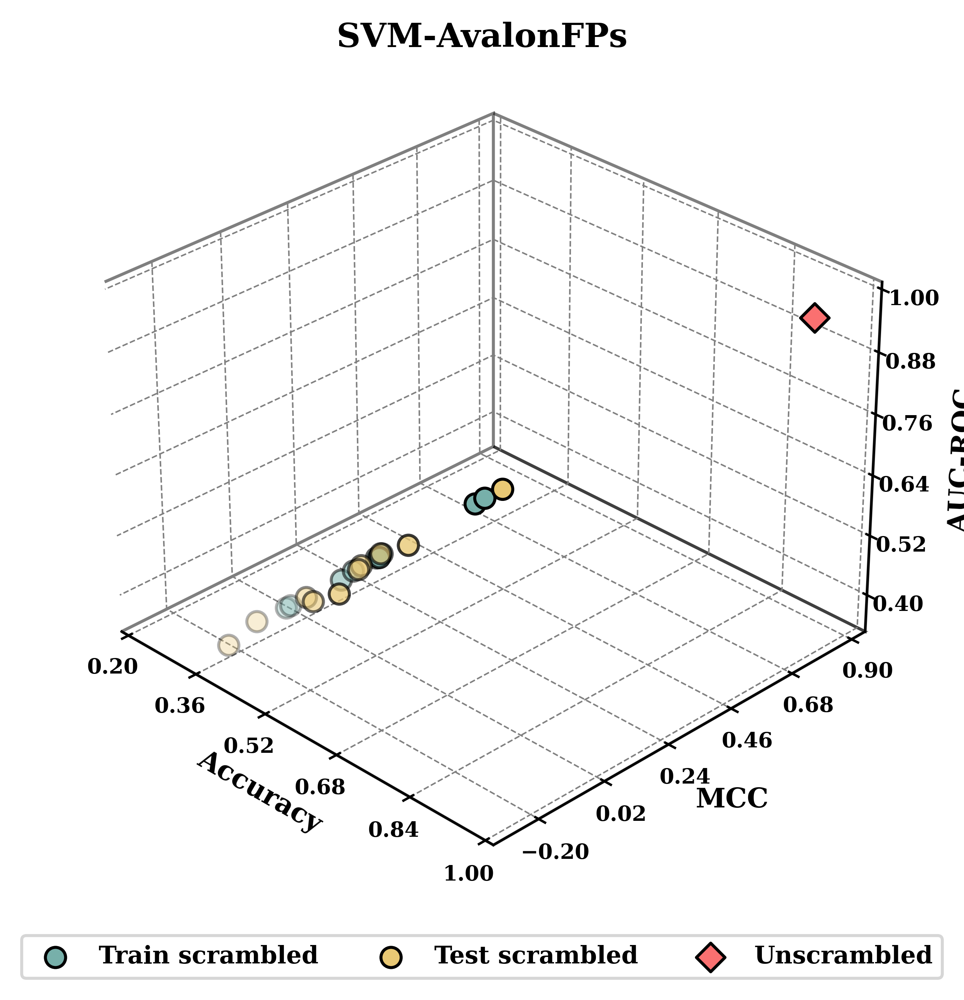

In [60]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./AvalonFPs-SVM/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./AvalonFPs-SVM/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./AvalonFPs-SVM/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('SVM-AvalonFPs', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./AvalonFPs-SVM/SVM-AvalonFPs.svg", format='svg', dpi=600)
plt.show()

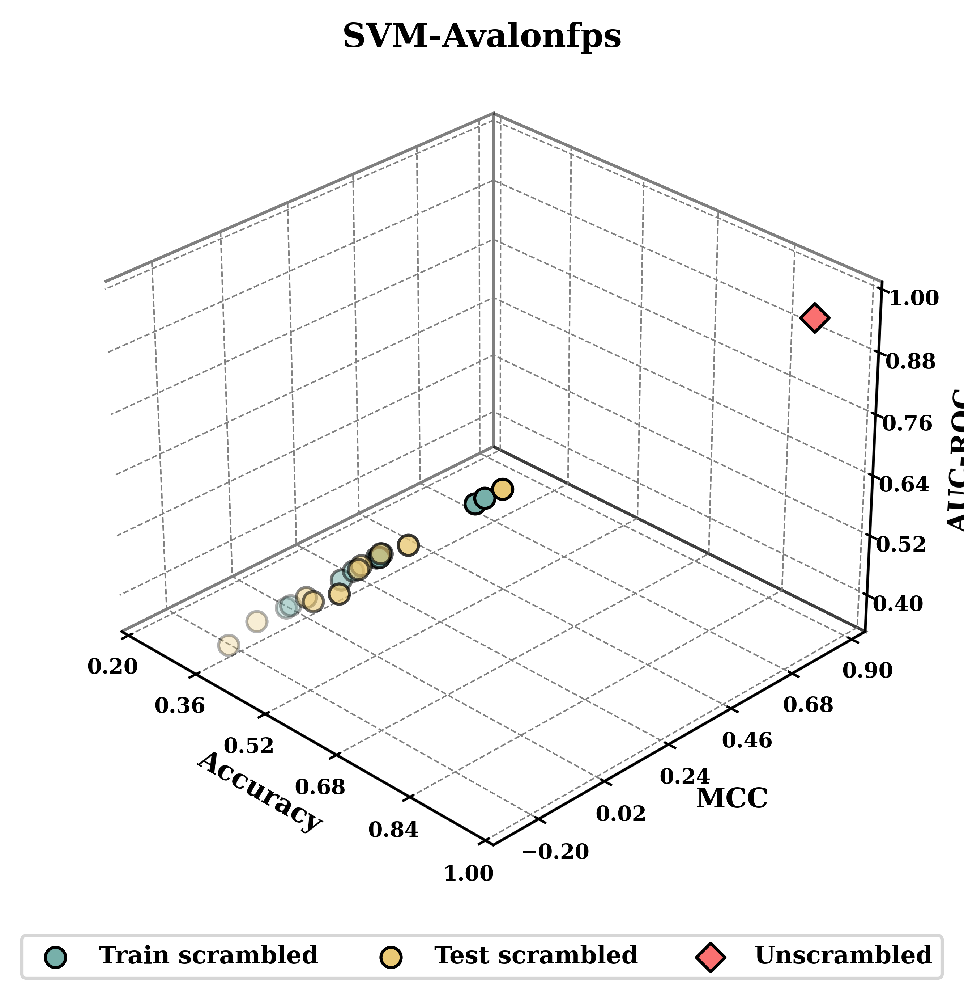

In [61]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./AvalonFPs-SVM/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./AvalonFPs-SVM/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./AvalonFPs-SVM/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('SVM-Avalonfps', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./AvalonFPs-SVM/SVM-Avalonfps.svg", format='svg', dpi=600)
plt.show()

### TTFPs-XGB

In [62]:
import xgboost as xgb
from xgboost import plot_importance
from xgboost.sklearn import XGBClassifier
def train_model(X_train, Y_train):
    """Train model with specified parameters."""
    ###########   修改模型
    model = XGB = XGBClassifier(
    random_state=0,  # 随机种子，保证可复现性
    objective='binary:logistic',  # 目标函数为二元逻辑回归
    colsample_bytree=0.8,  # 构造每棵树时列的采样率
    gamma=0.0,  # 叶子节点分裂所需的最小损失减少
    max_depth=9,  # 最大深度
    min_child_weight=1,  # 孩子节点所需的最小权重和
    n_estimators=40,  # 树的个数
    reg_alpha=0.1,  # L1正则化系数
    reg_lambda=0.1,  # L2正则化系数
    subsample=0.8  # 训练每棵树时样本的采样率
)

    model.fit(X_train, Y_train)
    return model

def save_results_to_csv(data, filename):
    """Save DataFrame to a CSV file."""
    data.to_csv(filename, index=False)
    print(f"Data saved to {filename}.")
    
#模型扰动
def scramble_and_validate(model, X, Y, dataset_name="train"):
    """Scramble model and validate on specified dataset."""
    #scrambler = Scrambler(model=mlp, iterations=100)
    scrambler = Scrambler(model=model, iterations=100)
    results = scrambler.validate(X, Y, scoring="accuracy", 
                                 cross_val_score_aggregator="mean", 
                                 pvalue_threshold=0.01, 
                                 as_df=True)
    # Save results to CSV file specific to the dataset
    results_filename = f"{dataset_name}_validation_results.csv"
    save_results_to_csv(results, results_filename)
    return results

# 存储原始模型的数据
def process_original_model_results(results, filename):
    original_model_data = results.iloc[0]
    original_model_metrics_df = pd.DataFrame({
        #'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'f1', 'Z-Score', 'P-Value', 'Significance'],
        'Metric': ['Accuracy', 'ROC AUC', 'MCC','P-Value', 'Significance'],
        'Value': [
            original_model_data['accuracy'],
            #original_model_data['recall'],
            #original_model_data['precision'],
            original_model_data['roc_auc'],
            original_model_data['mcc'],
            #original_model_data['f1'],
            #original_model_data['zscore'],
            original_model_data['pvalue'],
            '显著' if original_model_data['significancy'] else '不显著'
        ]
    })
    original_model_metrics_df.to_csv(filename, index=False)
    print(f"Original model metrics saved to {filename}.")
        
#随机提取训练集和测试集10次的扰动结果保存
def save_random_samples(results, dataset_name):
    """Save 10 random non-original model results to CSV."""
    if len(results) > 1:  # 除去原始模型至少还有1条数据
        # 排除第一行（原始模型数据）
        random_indices = np.random.choice(results.index[1:], size=min(10, len(results) - 1), replace=False)
        selected_scrambled_metrics = results.iloc[random_indices]
        filename = f"{dataset_name}_random_scrambled_metrics.csv"
        selected_scrambled_metrics.to_csv(filename, index=False)
        print(f"Random scrambled results saved to {filename}.")
    else:
        print(f"Not enough data to select from in {dataset_name} results.")

############# 读取数据
data = pd.read_csv('./TTFPs-XGB/MGAM-train-Topfps.csv')
data2 = pd.read_csv('./TTFPs-XGB/MGAM-test-Topfps.csv')

# 设置训练集和测试集的特征和标签
X_train = data.iloc[:, 2:]
Y_train = data.iloc[:, 1:2].values.ravel()
X_test = data2.iloc[:, 2:]
Y_test = data2.iloc[:, 1:2].values.ravel()

# 训练模型
model = train_model(X_train, Y_train)

# 验证模型并保存结果
train_results = scramble_and_validate(model, X_train, Y_train, "train")
test_results = scramble_and_validate(model, X_test, Y_test, "test")
    
# 保存原始模型指标
process_original_model_results(train_results, "original_train_model_metrics.csv")
process_original_model_results(test_results, "original_test_model_metrics.csv")

# 使用前面定义的函数来随机选取并保存扰动结果
save_random_samples(train_results, "train")
save_random_samples(test_results, "test")

Data saved to train_validation_results.csv.
Data saved to test_validation_results.csv.
Original model metrics saved to original_train_model_metrics.csv.
Original model metrics saved to original_test_model_metrics.csv.
Random scrambled results saved to train_random_scrambled_metrics.csv.
Random scrambled results saved to test_random_scrambled_metrics.csv.


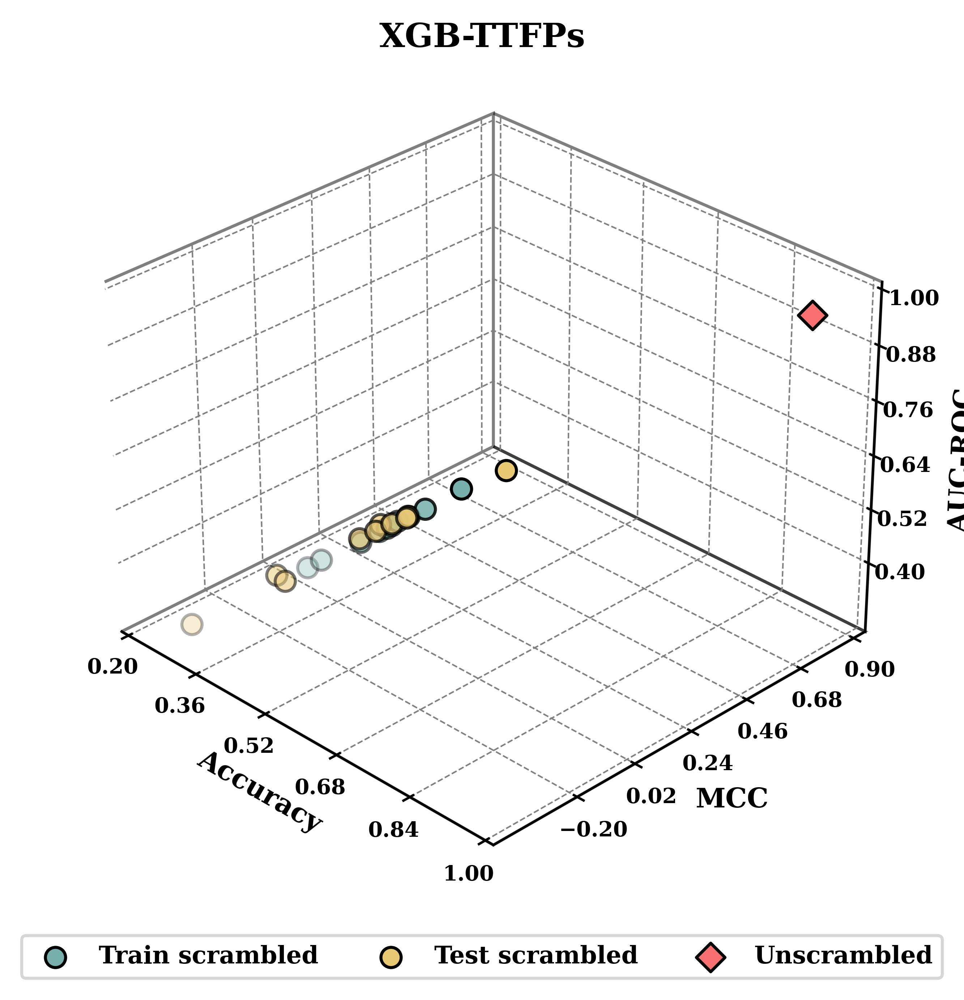

In [63]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./TTFPs-XGB/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./TTFPs-XGB/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./TTFPs-XGB/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('XGB-TTFPs', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./TTFPs-XGB/XGB-TTFPs.svg", format='svg', dpi=600)
plt.show()

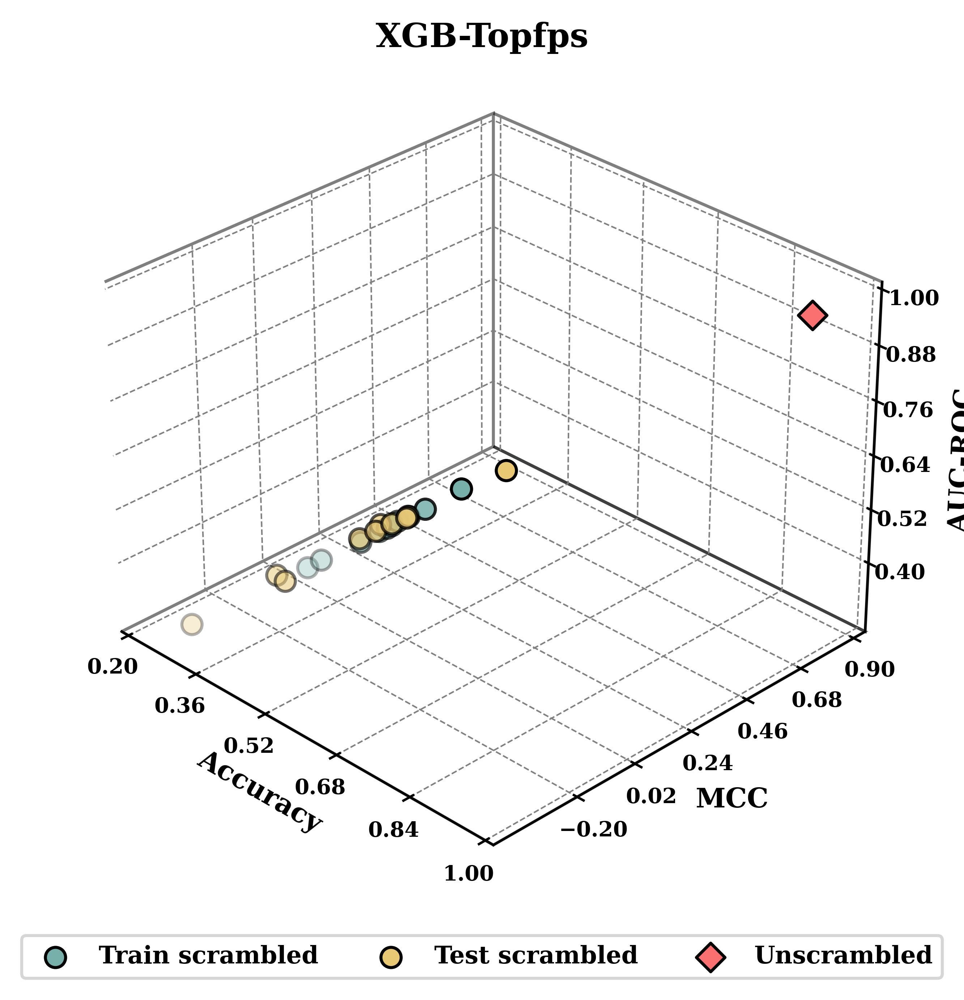

In [64]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./TTFPs-XGB/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./TTFPs-XGB/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./TTFPs-XGB/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('XGB-Topfps', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./TTFPs-XGB/XGB-Topfps.svg", format='svg', dpi=600)
plt.show()

### NtMGAM-RF

In [69]:
from sklearn.ensemble import RandomForestClassifier
def train_model(X_train, Y_train):
    """Train model with specified parameters."""
    ###########   修改模型
    model = RF = RandomForestClassifier(
    random_state=0,  # 设置随机种子，确保结果可重复
    class_weight='balanced',  # 类别权重，处理不平衡数据集
    criterion='gini',  # 评价分裂质量的标准，这里使用基尼不纯度
    max_features='sqrt',  # 寻找最佳分裂时考虑的特征数，这里使用log2
    bootstrap=False,  # 是否使用bootstrap样本
    max_depth=20,  # 树的最大深度
    min_samples_leaf=3,  # 叶节点最少样本数
    min_samples_split=5,  # 分裂内部节点所需的最小样本数
    n_estimators=187,  # 构建的树的数量
    oob_score=False  # 是否使用袋外样本来评估精度
)
    model.fit(X_train, Y_train)
    return model

def save_results_to_csv(data, filename):
    """Save DataFrame to a CSV file."""
    data.to_csv(filename, index=False)
    print(f"Data saved to {filename}.")
    
#模型扰动
def scramble_and_validate(model, X, Y, dataset_name="train"):
    """Scramble model and validate on specified dataset."""
    #scrambler = Scrambler(model=mlp, iterations=100)
    scrambler = Scrambler(model=model, iterations=100)
    results = scrambler.validate(X, Y, scoring="accuracy", 
                                 cross_val_score_aggregator="mean", 
                                 pvalue_threshold=0.01, 
                                 as_df=True)
    # Save results to CSV file specific to the dataset
    results_filename = f"{dataset_name}_validation_results.csv"
    save_results_to_csv(results, results_filename)
    return results

# 存储原始模型的数据
def process_original_model_results(results, filename):
    original_model_data = results.iloc[0]
    original_model_metrics_df = pd.DataFrame({
        #'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'f1', 'Z-Score', 'P-Value', 'Significance'],
        'Metric': ['Accuracy', 'ROC AUC', 'MCC','P-Value', 'Significance'],
        'Value': [
            original_model_data['accuracy'],
            #original_model_data['recall'],
            #original_model_data['precision'],
            original_model_data['roc_auc'],
            original_model_data['mcc'],
            #original_model_data['f1'],
            #original_model_data['zscore'],
            original_model_data['pvalue'],
            '显著' if original_model_data['significancy'] else '不显著'
        ]
    })
    original_model_metrics_df.to_csv(filename, index=False)
    print(f"Original model metrics saved to {filename}.")
        
#随机提取训练集和测试集10次的扰动结果保存
def save_random_samples(results, dataset_name):
    """Save 10 random non-original model results to CSV."""
    if len(results) > 1:  # 除去原始模型至少还有1条数据
        # 排除第一行（原始模型数据）
        random_indices = np.random.choice(results.index[1:], size=min(10, len(results) - 1), replace=False)
        selected_scrambled_metrics = results.iloc[random_indices]
        filename = f"{dataset_name}_random_scrambled_metrics.csv"
        selected_scrambled_metrics.to_csv(filename, index=False)
        print(f"Random scrambled results saved to {filename}.")
    else:
        print(f"Not enough data to select from in {dataset_name} results.")

############# 读取数据
data = pd.read_csv('./NtMGAM-IFP/MGAM-Res-train-2qmj.csv')
data2 = pd.read_csv('./NtMGAM-IFP/MGAM-Res-test-2qmj.csv')

# 设置训练集和测试集的特征和标签
X_train = data.iloc[:, 2:]
Y_train = data.iloc[:, 1:2].values.ravel()
X_test = data2.iloc[:, 2:]
Y_test = data2.iloc[:, 1:2].values.ravel()

# 训练模型
model = train_model(X_train, Y_train)

# 验证模型并保存结果
train_results = scramble_and_validate(model, X_train, Y_train, "train")
test_results = scramble_and_validate(model, X_test, Y_test, "test")
    
# 保存原始模型指标
process_original_model_results(train_results, "original_train_model_metrics.csv")
process_original_model_results(test_results, "original_test_model_metrics.csv")

# 使用前面定义的函数来随机选取并保存扰动结果
save_random_samples(train_results, "train")
save_random_samples(test_results, "test")

Data saved to train_validation_results.csv.
Data saved to test_validation_results.csv.
Original model metrics saved to original_train_model_metrics.csv.
Original model metrics saved to original_test_model_metrics.csv.
Random scrambled results saved to train_random_scrambled_metrics.csv.
Random scrambled results saved to test_random_scrambled_metrics.csv.


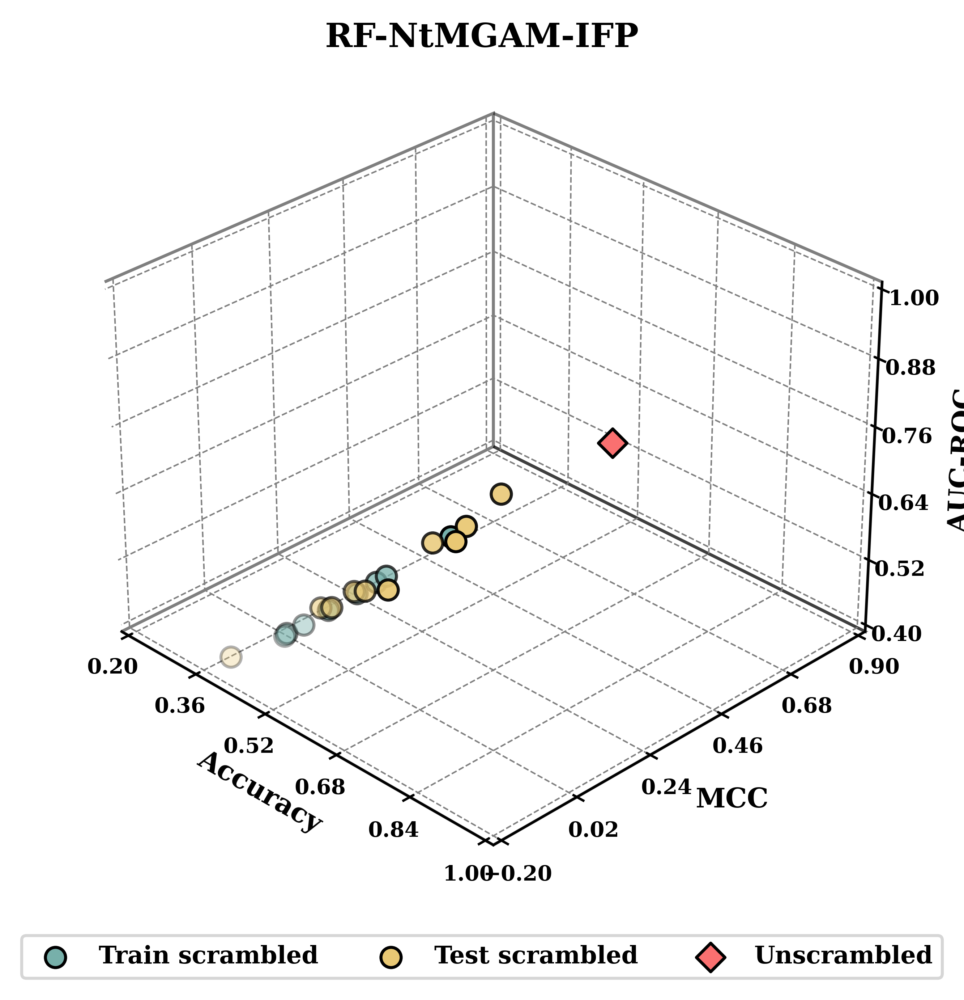

In [70]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./NtMGAM-IFP/RF/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./NtMGAM-IFP/RF/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./NtMGAM-IFP/RF/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('RF-NtMGAM-IFP', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./NtMGAM-IFP/RF/RF-NtMGAM-IFP.svg", format='svg', dpi=600)
plt.show()

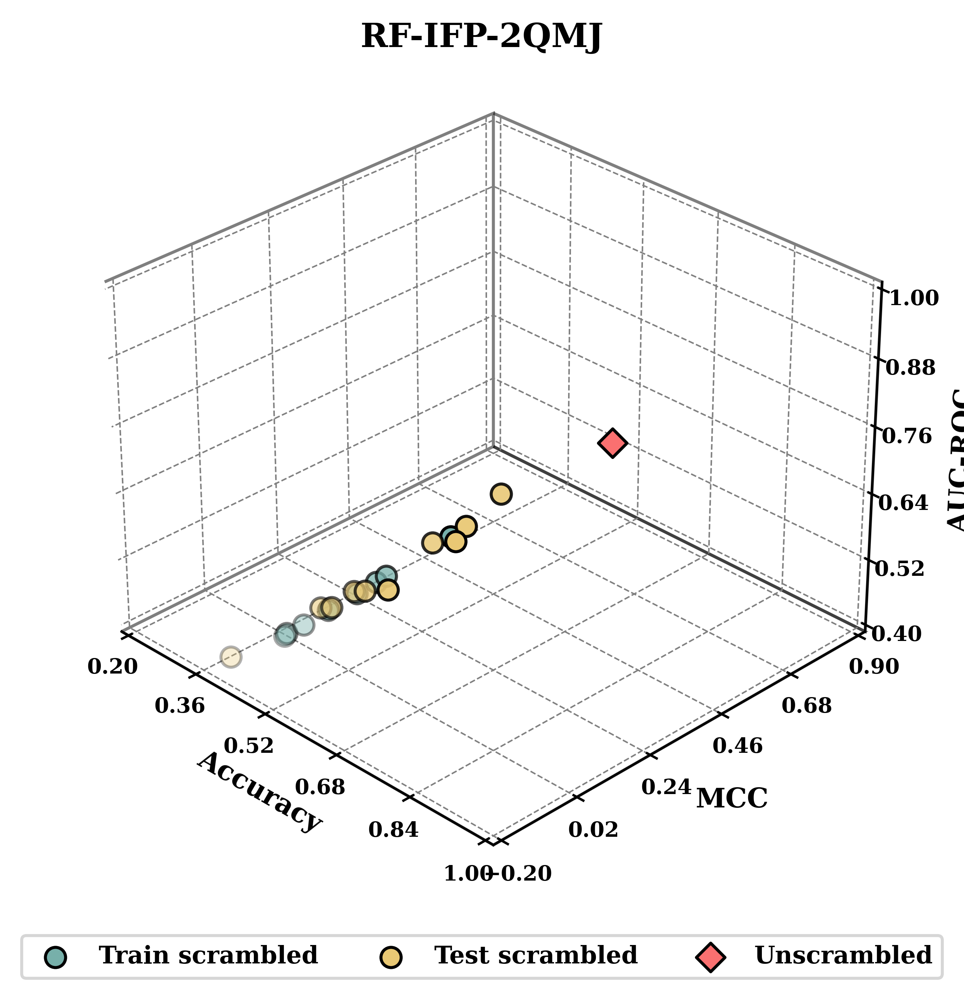

In [75]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./NtMGAM-IFP/RF/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./NtMGAM-IFP/RF/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./NtMGAM-IFP/RF/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('RF-IFP-2QMJ', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./NtMGAM-IFP/RF/RF-IFP-2QMJ.svg", format='svg', dpi=600)
plt.show()

### NtMGAM-XGB

In [66]:
from xgboost import plot_importance
from xgboost.sklearn import XGBClassifier
def train_model(X_train, Y_train):
    """Train model with specified parameters."""
    ###########   修改模型
    model = XGB = XGBClassifier(
    random_state=0,  # 随机种子，保证可复现性
    objective='binary:logistic',  # 目标函数为二元逻辑回归
    colsample_bytree=0.6,  # 构造每棵树时列的采样率
    gamma=0.0,  # 叶子节点分裂所需的最小损失减少
    max_depth=9,  # 最大深度
    min_child_weight=1,  # 孩子节点所需的最小权重和
    n_estimators=30,  # 树的个数
    reg_alpha=0.1,  # L1正则化系数
    reg_lambda=0.1,  # L2正则化系数
    subsample=0.9  # 训练每棵树时样本的采样率
)
    model.fit(X_train, Y_train)
    return model

def save_results_to_csv(data, filename):
    """Save DataFrame to a CSV file."""
    data.to_csv(filename, index=False)
    print(f"Data saved to {filename}.")
    
#模型扰动
def scramble_and_validate(model, X, Y, dataset_name="train"):
    """Scramble model and validate on specified dataset."""
    #scrambler = Scrambler(model=mlp, iterations=100)
    scrambler = Scrambler(model=model, iterations=100)
    results = scrambler.validate(X, Y, scoring="accuracy", 
                                 cross_val_score_aggregator="mean", 
                                 pvalue_threshold=0.01, 
                                 as_df=True)
    # Save results to CSV file specific to the dataset
    results_filename = f"{dataset_name}_validation_results.csv"
    save_results_to_csv(results, results_filename)
    return results

# 存储原始模型的数据
def process_original_model_results(results, filename):
    original_model_data = results.iloc[0]
    original_model_metrics_df = pd.DataFrame({
        #'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'f1', 'Z-Score', 'P-Value', 'Significance'],
        'Metric': ['Accuracy', 'ROC AUC', 'MCC','P-Value', 'Significance'],
        'Value': [
            original_model_data['accuracy'],
            #original_model_data['recall'],
            #original_model_data['precision'],
            original_model_data['roc_auc'],
            original_model_data['mcc'],
            #original_model_data['f1'],
            #original_model_data['zscore'],
            original_model_data['pvalue'],
            '显著' if original_model_data['significancy'] else '不显著'
        ]
    })
    original_model_metrics_df.to_csv(filename, index=False)
    print(f"Original model metrics saved to {filename}.")
        
#随机提取训练集和测试集10次的扰动结果保存
def save_random_samples(results, dataset_name):
    """Save 10 random non-original model results to CSV."""
    if len(results) > 1:  # 除去原始模型至少还有1条数据
        # 排除第一行（原始模型数据）
        random_indices = np.random.choice(results.index[1:], size=min(10, len(results) - 1), replace=False)
        selected_scrambled_metrics = results.iloc[random_indices]
        filename = f"{dataset_name}_random_scrambled_metrics.csv"
        selected_scrambled_metrics.to_csv(filename, index=False)
        print(f"Random scrambled results saved to {filename}.")
    else:
        print(f"Not enough data to select from in {dataset_name} results.")

############# 读取数据
data = pd.read_csv('./NtMGAM-IFP/MGAM-Res-train-2qmj.csv')
data2 = pd.read_csv('./NtMGAM-IFP/MGAM-Res-test-2qmj.csv')

# 设置训练集和测试集的特征和标签
X_train = data.iloc[:, 2:]
Y_train = data.iloc[:, 1:2].values.ravel()
X_test = data2.iloc[:, 2:]
Y_test = data2.iloc[:, 1:2].values.ravel()

# 训练模型
model = train_model(X_train, Y_train)

# 验证模型并保存结果
train_results = scramble_and_validate(model, X_train, Y_train, "train")
test_results = scramble_and_validate(model, X_test, Y_test, "test")
    
# 保存原始模型指标
process_original_model_results(train_results, "original_train_model_metrics.csv")
process_original_model_results(test_results, "original_test_model_metrics.csv")

# 使用前面定义的函数来随机选取并保存扰动结果
save_random_samples(train_results, "train")
save_random_samples(test_results, "test")

Data saved to train_validation_results.csv.
Data saved to test_validation_results.csv.
Original model metrics saved to original_train_model_metrics.csv.
Original model metrics saved to original_test_model_metrics.csv.
Random scrambled results saved to train_random_scrambled_metrics.csv.
Random scrambled results saved to test_random_scrambled_metrics.csv.


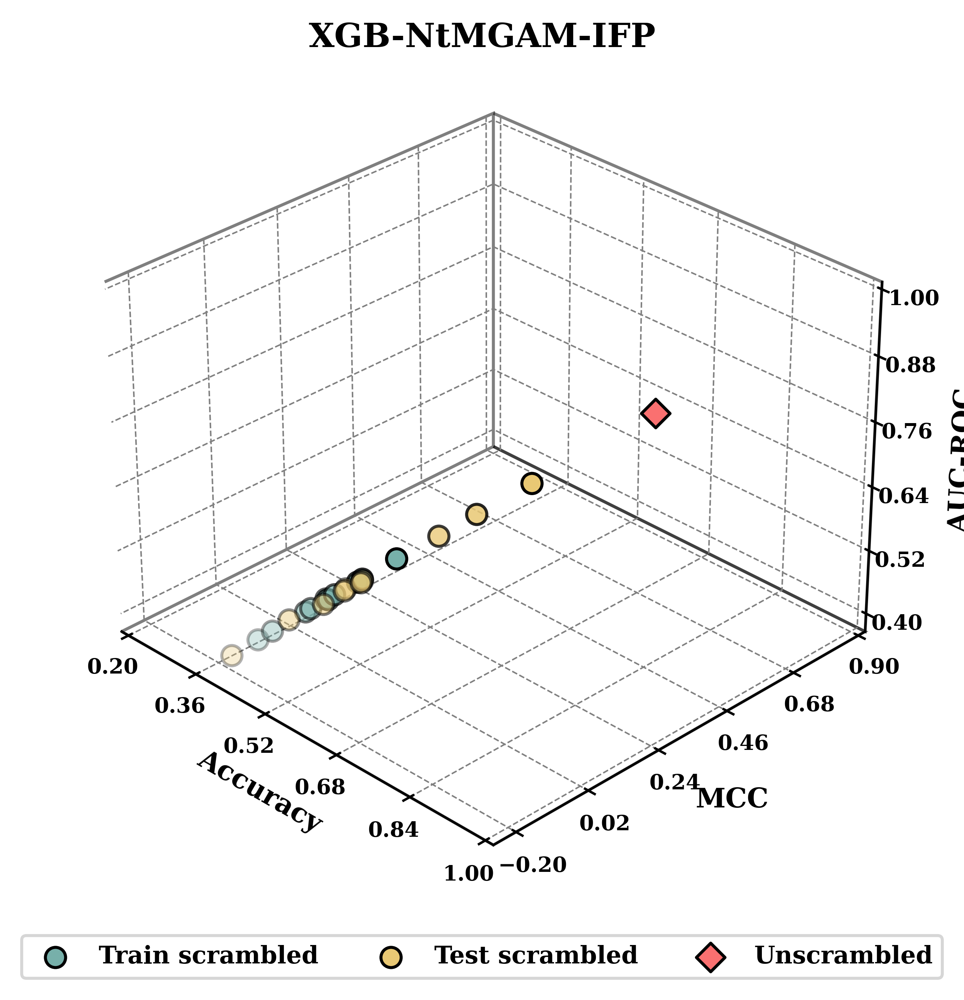

In [67]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./NtMGAM-IFP/XGB/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./NtMGAM-IFP/XGB/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./NtMGAM-IFP/XGB/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('XGB-NtMGAM-IFP', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./NtMGAM-IFP/XGB/XGB-NtMGAM-IFP.svg", format='svg', dpi=600)
plt.show()

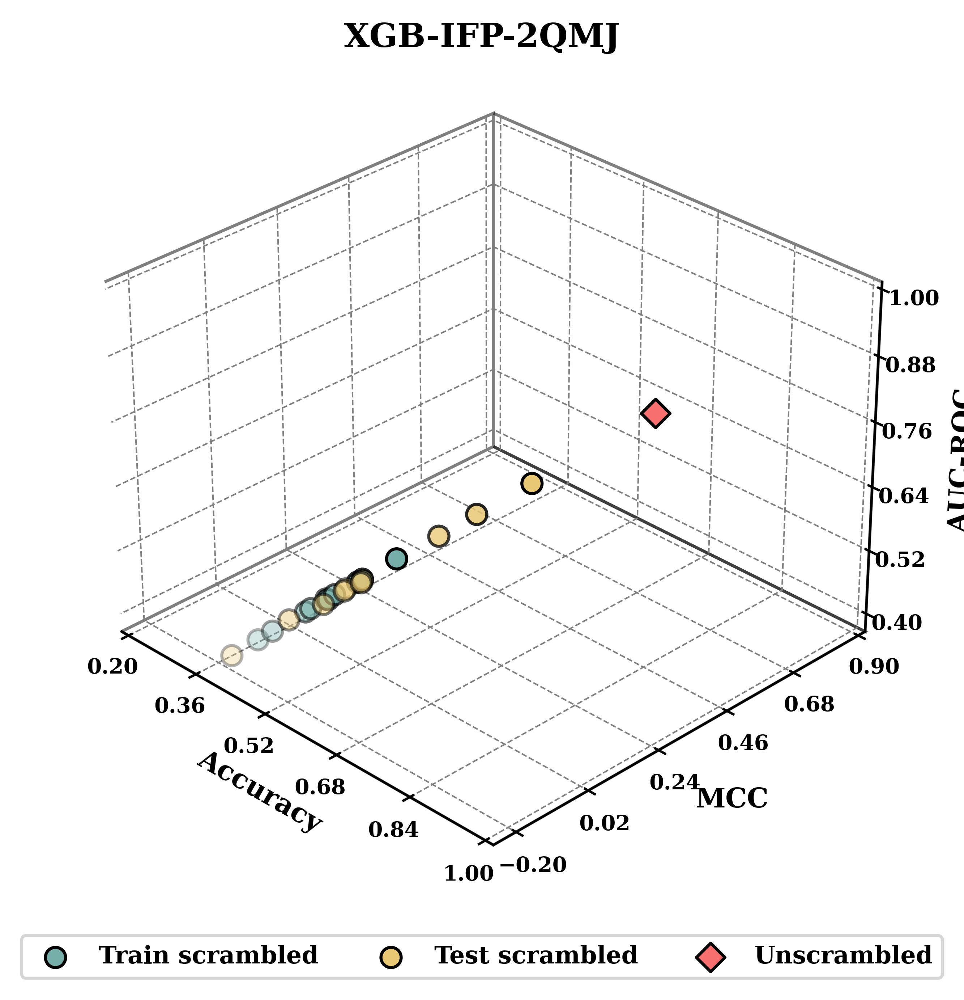

In [68]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./NtMGAM-IFP/XGB/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./NtMGAM-IFP/XGB/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./NtMGAM-IFP/XGB/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('XGB-IFP-2QMJ', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./NtMGAM-IFP/XGB/XGB-IFP-2QMJ.svg", format='svg', dpi=600)
plt.show()

### CtMGAM-RF

In [73]:
from sklearn.ensemble import RandomForestClassifier
def train_model(X_train, Y_train):
    """Train model with specified parameters."""
    ###########   修改模型
    model = RF = RandomForestClassifier(
    random_state=0,  # 设置随机种子，确保结果可重复
    class_weight='balanced',  # 类别权重，处理不平衡数据集
    criterion='gini',  # 评价分裂质量的标准，这里使用基尼不纯度
    max_features='sqrt',  # 寻找最佳分裂时考虑的特征数，这里使用log2
    bootstrap=False,  # 是否使用bootstrap样本
    max_depth=20,  # 树的最大深度
    min_samples_leaf=3,  # 叶节点最少样本数
    min_samples_split=5,  # 分裂内部节点所需的最小样本数
    n_estimators=165,  # 构建的树的数量
    oob_score=False  # 是否使用袋外样本来评估精度
)
    model.fit(X_train, Y_train)
    return model

def save_results_to_csv(data, filename):
    """Save DataFrame to a CSV file."""
    data.to_csv(filename, index=False)
    print(f"Data saved to {filename}.")
    
#模型扰动
def scramble_and_validate(model, X, Y, dataset_name="train"):
    """Scramble model and validate on specified dataset."""
    #scrambler = Scrambler(model=mlp, iterations=100)
    scrambler = Scrambler(model=model, iterations=100)
    results = scrambler.validate(X, Y, scoring="accuracy", 
                                 cross_val_score_aggregator="mean", 
                                 pvalue_threshold=0.01, 
                                 as_df=True)
    # Save results to CSV file specific to the dataset
    results_filename = f"{dataset_name}_validation_results.csv"
    save_results_to_csv(results, results_filename)
    return results

# 存储原始模型的数据
def process_original_model_results(results, filename):
    original_model_data = results.iloc[0]
    original_model_metrics_df = pd.DataFrame({
        #'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'f1', 'Z-Score', 'P-Value', 'Significance'],
        'Metric': ['Accuracy', 'ROC AUC', 'MCC','P-Value', 'Significance'],
        'Value': [
            original_model_data['accuracy'],
            #original_model_data['recall'],
            #original_model_data['precision'],
            original_model_data['roc_auc'],
            original_model_data['mcc'],
            #original_model_data['f1'],
            #original_model_data['zscore'],
            original_model_data['pvalue'],
            '显著' if original_model_data['significancy'] else '不显著'
        ]
    })
    original_model_metrics_df.to_csv(filename, index=False)
    print(f"Original model metrics saved to {filename}.")
        
#随机提取训练集和测试集10次的扰动结果保存
def save_random_samples(results, dataset_name):
    """Save 10 random non-original model results to CSV."""
    if len(results) > 1:  # 除去原始模型至少还有1条数据
        # 排除第一行（原始模型数据）
        random_indices = np.random.choice(results.index[1:], size=min(10, len(results) - 1), replace=False)
        selected_scrambled_metrics = results.iloc[random_indices]
        filename = f"{dataset_name}_random_scrambled_metrics.csv"
        selected_scrambled_metrics.to_csv(filename, index=False)
        print(f"Random scrambled results saved to {filename}.")
    else:
        print(f"Not enough data to select from in {dataset_name} results.")

############# 读取数据
data = pd.read_csv('./CtMGAM-IFP/MGAM_train_3top02.csv')
data2 = pd.read_csv('./CtMGAM-IFP/MGAM_test_3top02.csv')

# 设置训练集和测试集的特征和标签
X_train = data.iloc[:, 3:]
Y_train = data.iloc[:, 2:3].values.ravel()
X_test = data2.iloc[:, 3:]
Y_test = data2.iloc[:, 2:3].values.ravel()

# 训练模型
model = train_model(X_train, Y_train)

# 验证模型并保存结果
train_results = scramble_and_validate(model, X_train, Y_train, "train")
test_results = scramble_and_validate(model, X_test, Y_test, "test")
    
# 保存原始模型指标
process_original_model_results(train_results, "original_train_model_metrics.csv")
process_original_model_results(test_results, "original_test_model_metrics.csv")

# 使用前面定义的函数来随机选取并保存扰动结果
save_random_samples(train_results, "train")
save_random_samples(test_results, "test")

Data saved to train_validation_results.csv.
Data saved to test_validation_results.csv.
Original model metrics saved to original_train_model_metrics.csv.
Original model metrics saved to original_test_model_metrics.csv.
Random scrambled results saved to train_random_scrambled_metrics.csv.
Random scrambled results saved to test_random_scrambled_metrics.csv.


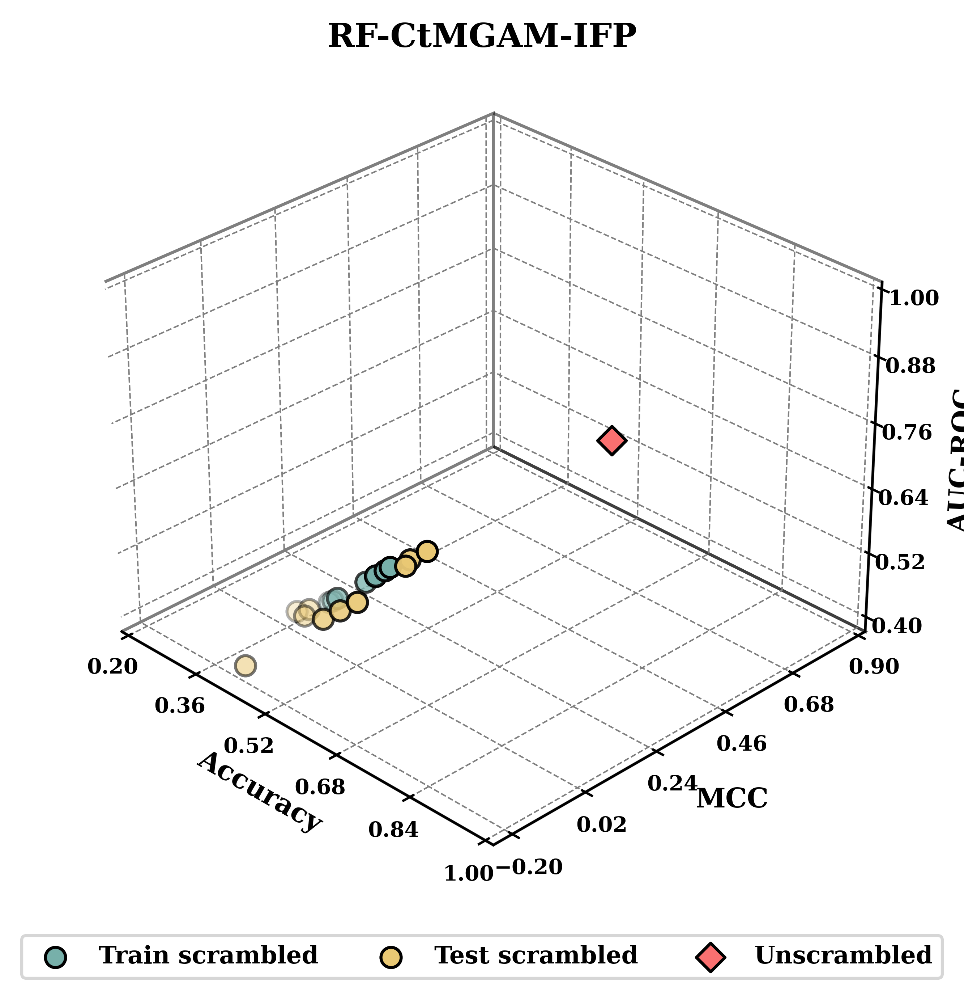

In [74]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./CtMGAM-IFP/RF/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./CtMGAM-IFP/RF/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./CtMGAM-IFP/RF/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('RF-CtMGAM-IFP', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./CtMGAM-IFP/RF/RF-CtMGAM-IFP.svg", format='svg', dpi=600)
plt.show()

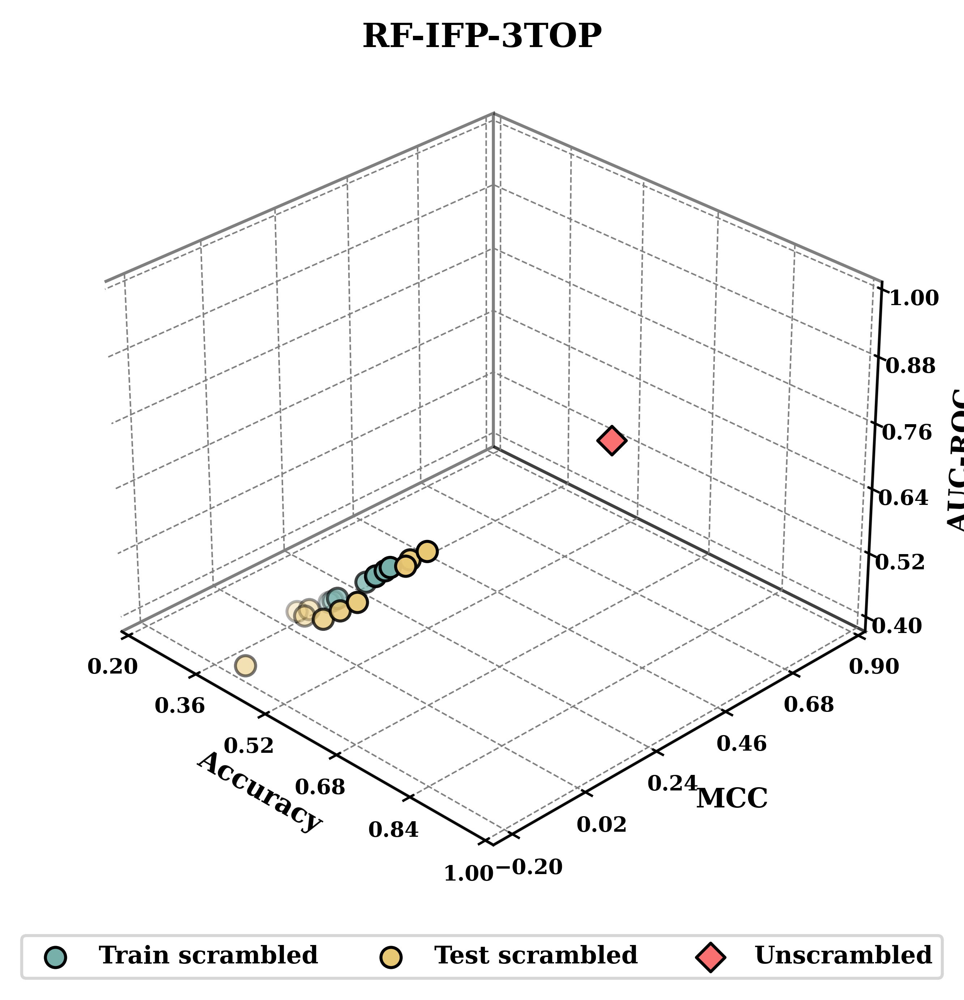

In [76]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./CtMGAM-IFP/RF/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./CtMGAM-IFP/RF/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./CtMGAM-IFP/RF/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('RF-IFP-3TOP', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./CtMGAM-IFP/RF/RF-IFP-3TOP.svg", format='svg', dpi=600)
plt.show()

### CtMGAM-GBT

In [77]:
from sklearn.ensemble import GradientBoostingClassifier
def train_model(X_train, Y_train):
    """Train model with specified parameters."""
    ###########   修改模型
    model = GBT = GradientBoostingClassifier(random_state=0,
                                 criterion='friedman_mse',
                                 max_depth=12,
                                 max_features='sqrt',
                                 min_samples_leaf=3,
                                 min_samples_split=5,
                                 n_estimators=159)
    model.fit(X_train, Y_train)
    return model

def save_results_to_csv(data, filename):
    """Save DataFrame to a CSV file."""
    data.to_csv(filename, index=False)
    print(f"Data saved to {filename}.")
    
#模型扰动
def scramble_and_validate(model, X, Y, dataset_name="train"):
    """Scramble model and validate on specified dataset."""
    #scrambler = Scrambler(model=mlp, iterations=100)
    scrambler = Scrambler(model=model, iterations=100)
    results = scrambler.validate(X, Y, scoring="accuracy", 
                                 cross_val_score_aggregator="mean", 
                                 pvalue_threshold=0.01, 
                                 as_df=True)
    # Save results to CSV file specific to the dataset
    results_filename = f"{dataset_name}_validation_results.csv"
    save_results_to_csv(results, results_filename)
    return results

# 存储原始模型的数据
def process_original_model_results(results, filename):
    original_model_data = results.iloc[0]
    original_model_metrics_df = pd.DataFrame({
        #'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'f1', 'Z-Score', 'P-Value', 'Significance'],
        'Metric': ['Accuracy', 'ROC AUC', 'MCC','P-Value', 'Significance'],
        'Value': [
            original_model_data['accuracy'],
            #original_model_data['recall'],
            #original_model_data['precision'],
            original_model_data['roc_auc'],
            original_model_data['mcc'],
            #original_model_data['f1'],
            #original_model_data['zscore'],
            original_model_data['pvalue'],
            '显著' if original_model_data['significancy'] else '不显著'
        ]
    })
    original_model_metrics_df.to_csv(filename, index=False)
    print(f"Original model metrics saved to {filename}.")
        
#随机提取训练集和测试集10次的扰动结果保存
def save_random_samples(results, dataset_name):
    """Save 10 random non-original model results to CSV."""
    if len(results) > 1:  # 除去原始模型至少还有1条数据
        # 排除第一行（原始模型数据）
        random_indices = np.random.choice(results.index[1:], size=min(10, len(results) - 1), replace=False)
        selected_scrambled_metrics = results.iloc[random_indices]
        filename = f"{dataset_name}_random_scrambled_metrics.csv"
        selected_scrambled_metrics.to_csv(filename, index=False)
        print(f"Random scrambled results saved to {filename}.")
    else:
        print(f"Not enough data to select from in {dataset_name} results.")

############# 读取数据
data = pd.read_csv('./CtMGAM-IFP/MGAM_train_3top02.csv')
data2 = pd.read_csv('./CtMGAM-IFP/MGAM_test_3top02.csv')

# 设置训练集和测试集的特征和标签
X_train = data.iloc[:, 3:]
Y_train = data.iloc[:, 2:3].values.ravel()
X_test = data2.iloc[:, 3:]
Y_test = data2.iloc[:, 2:3].values.ravel()

# 训练模型
model = train_model(X_train, Y_train)

# 验证模型并保存结果
train_results = scramble_and_validate(model, X_train, Y_train, "train")
test_results = scramble_and_validate(model, X_test, Y_test, "test")
    
# 保存原始模型指标
process_original_model_results(train_results, "original_train_model_metrics.csv")
process_original_model_results(test_results, "original_test_model_metrics.csv")

# 使用前面定义的函数来随机选取并保存扰动结果
save_random_samples(train_results, "train")
save_random_samples(test_results, "test")

Data saved to train_validation_results.csv.
Data saved to test_validation_results.csv.
Original model metrics saved to original_train_model_metrics.csv.
Original model metrics saved to original_test_model_metrics.csv.
Random scrambled results saved to train_random_scrambled_metrics.csv.
Random scrambled results saved to test_random_scrambled_metrics.csv.


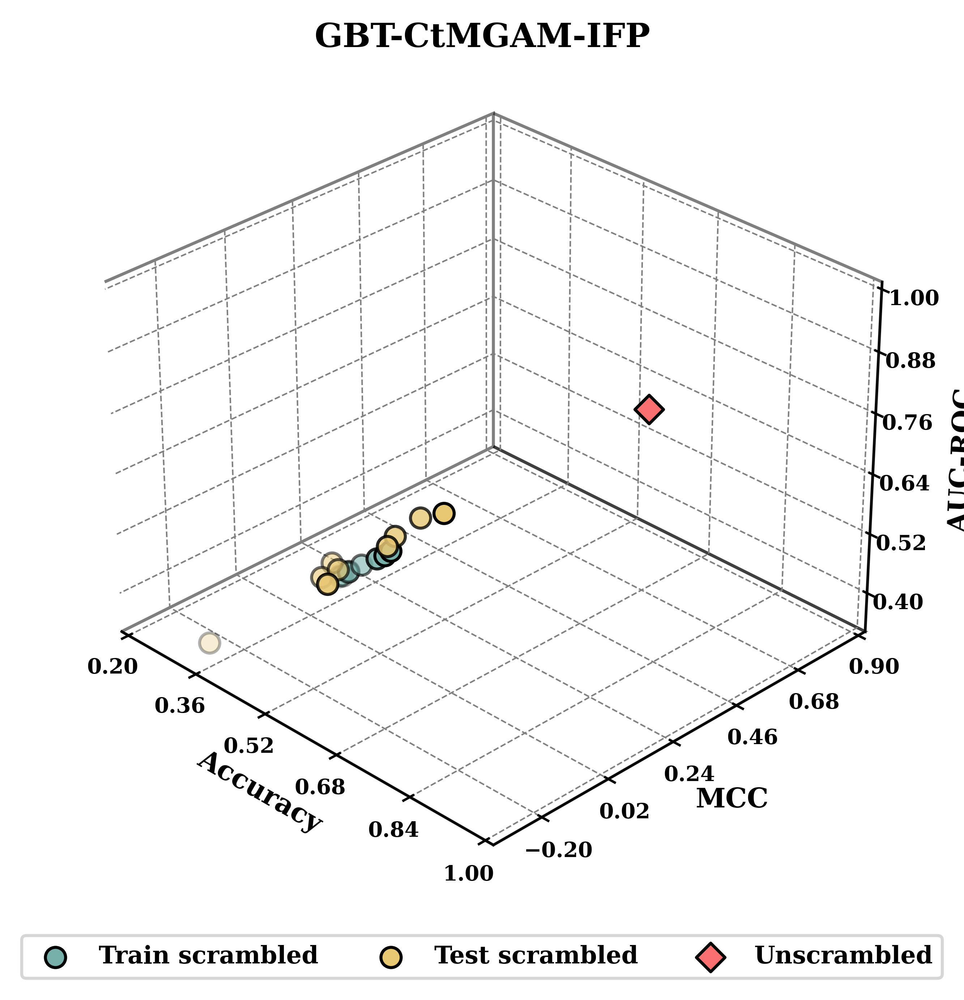

In [78]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./CtMGAM-IFP/GBT/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./CtMGAM-IFP/GBT/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./CtMGAM-IFP/GBT/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('GBT-CtMGAM-IFP', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./CtMGAM-IFP/GBT/GBT-CtMGAM-IFP.svg", format='svg', dpi=600)
plt.show()

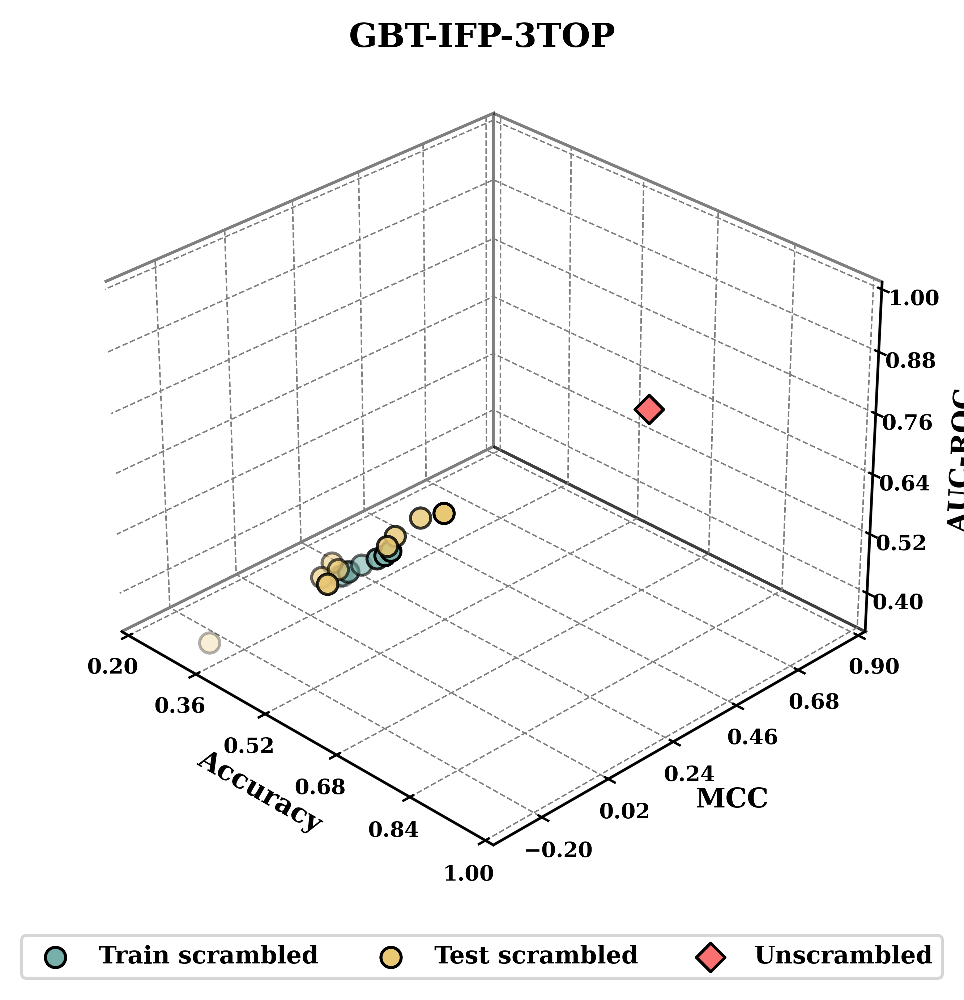

In [79]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./CtMGAM-IFP/GBT/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./CtMGAM-IFP/GBT/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./CtMGAM-IFP/GBT/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('GBT-IFP-3TOP', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./CtMGAM-IFP/GBT/GBT-IFP-3TOP.svg", format='svg', dpi=600)
plt.show()

### CtMGAM-KNN

In [80]:
from sklearn.neighbors import KNeighborsClassifier
def train_model(X_train, Y_train):
    """Train model with specified parameters."""
    ###########   修改模型
    model = KNN = KNeighborsClassifier(
    n_jobs=1,  # 使用所有可用CPU
    algorithm='auto',  # 使用KD树算法查找最近邻
    n_neighbors=7,  # 最近邻数量
    p=1,  # 使用曼哈顿距离
    weights='distance'  # 所有点权重相同
)
    model.fit(X_train, Y_train)
    return model

def save_results_to_csv(data, filename):
    """Save DataFrame to a CSV file."""
    data.to_csv(filename, index=False)
    print(f"Data saved to {filename}.")
    
#模型扰动
def scramble_and_validate(model, X, Y, dataset_name="train"):
    """Scramble model and validate on specified dataset."""
    #scrambler = Scrambler(model=mlp, iterations=100)
    scrambler = Scrambler(model=model, iterations=100)
    results = scrambler.validate(X, Y, scoring="accuracy", 
                                 cross_val_score_aggregator="mean", 
                                 pvalue_threshold=0.01, 
                                 as_df=True)
    # Save results to CSV file specific to the dataset
    results_filename = f"{dataset_name}_validation_results.csv"
    save_results_to_csv(results, results_filename)
    return results

# 存储原始模型的数据
def process_original_model_results(results, filename):
    original_model_data = results.iloc[0]
    original_model_metrics_df = pd.DataFrame({
        #'Metric': ['Accuracy', 'Recall', 'Precision', 'ROC AUC', 'MCC', 'f1', 'Z-Score', 'P-Value', 'Significance'],
        'Metric': ['Accuracy', 'ROC AUC', 'MCC','P-Value', 'Significance'],
        'Value': [
            original_model_data['accuracy'],
            #original_model_data['recall'],
            #original_model_data['precision'],
            original_model_data['roc_auc'],
            original_model_data['mcc'],
            #original_model_data['f1'],
            #original_model_data['zscore'],
            original_model_data['pvalue'],
            '显著' if original_model_data['significancy'] else '不显著'
        ]
    })
    original_model_metrics_df.to_csv(filename, index=False)
    print(f"Original model metrics saved to {filename}.")
        
#随机提取训练集和测试集10次的扰动结果保存
def save_random_samples(results, dataset_name):
    """Save 10 random non-original model results to CSV."""
    if len(results) > 1:  # 除去原始模型至少还有1条数据
        # 排除第一行（原始模型数据）
        random_indices = np.random.choice(results.index[1:], size=min(10, len(results) - 1), replace=False)
        selected_scrambled_metrics = results.iloc[random_indices]
        filename = f"{dataset_name}_random_scrambled_metrics.csv"
        selected_scrambled_metrics.to_csv(filename, index=False)
        print(f"Random scrambled results saved to {filename}.")
    else:
        print(f"Not enough data to select from in {dataset_name} results.")

############# 读取数据
data = pd.read_csv('./CtMGAM-IFP/MGAM_train_3top02.csv')
data2 = pd.read_csv('./CtMGAM-IFP/MGAM_test_3top02.csv')

# 设置训练集和测试集的特征和标签
X_train = data.iloc[:, 3:]
Y_train = data.iloc[:, 2:3].values.ravel()
X_test = data2.iloc[:, 3:]
Y_test = data2.iloc[:, 2:3].values.ravel()

# 训练模型
model = train_model(X_train, Y_train)

# 验证模型并保存结果
train_results = scramble_and_validate(model, X_train, Y_train, "train")
test_results = scramble_and_validate(model, X_test, Y_test, "test")
    
# 保存原始模型指标
process_original_model_results(train_results, "original_train_model_metrics.csv")
process_original_model_results(test_results, "original_test_model_metrics.csv")

# 使用前面定义的函数来随机选取并保存扰动结果
save_random_samples(train_results, "train")
save_random_samples(test_results, "test")

Data saved to train_validation_results.csv.
Data saved to test_validation_results.csv.
Original model metrics saved to original_train_model_metrics.csv.
Original model metrics saved to original_test_model_metrics.csv.
Random scrambled results saved to train_random_scrambled_metrics.csv.
Random scrambled results saved to test_random_scrambled_metrics.csv.


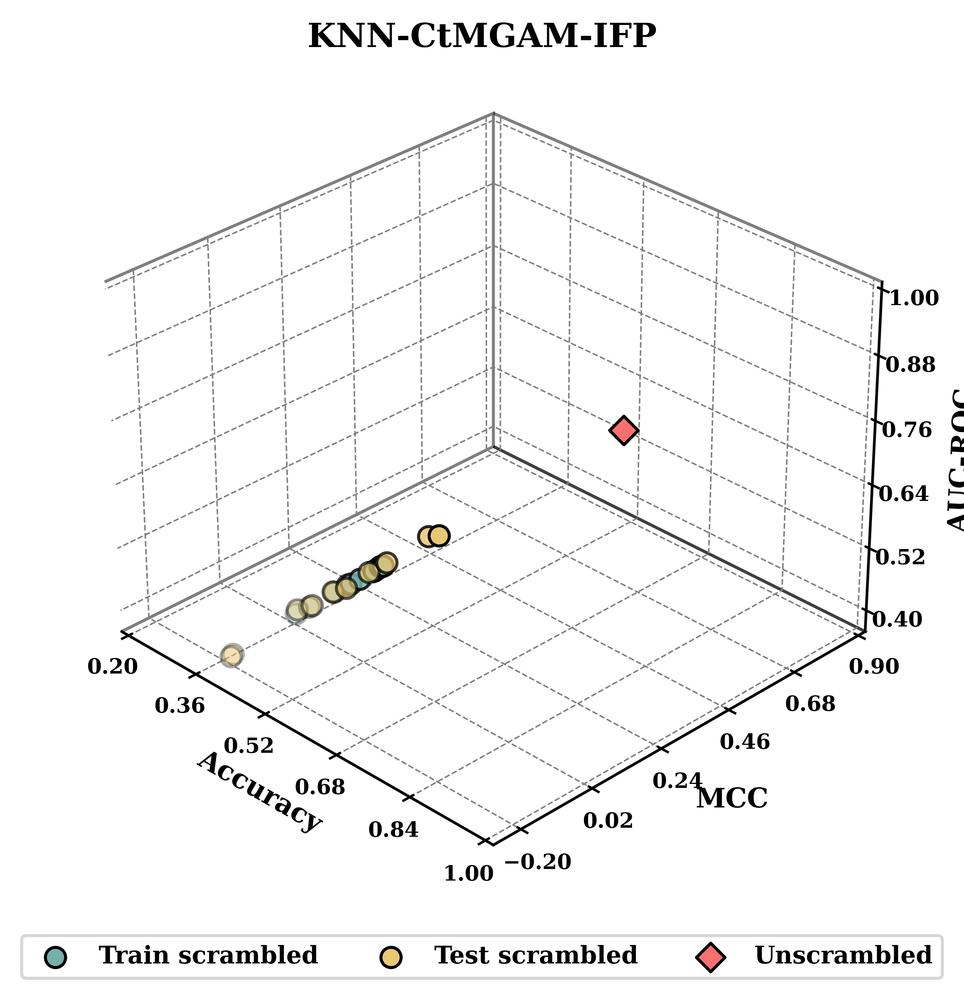

In [81]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./CtMGAM-IFP/KNN/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./CtMGAM-IFP/KNN/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./CtMGAM-IFP/KNN/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('KNN-CtMGAM-IFP', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./CtMGAM-IFP/KNN/KNN-CtMGAM-IFP.svg", format='svg', dpi=600)
plt.show()

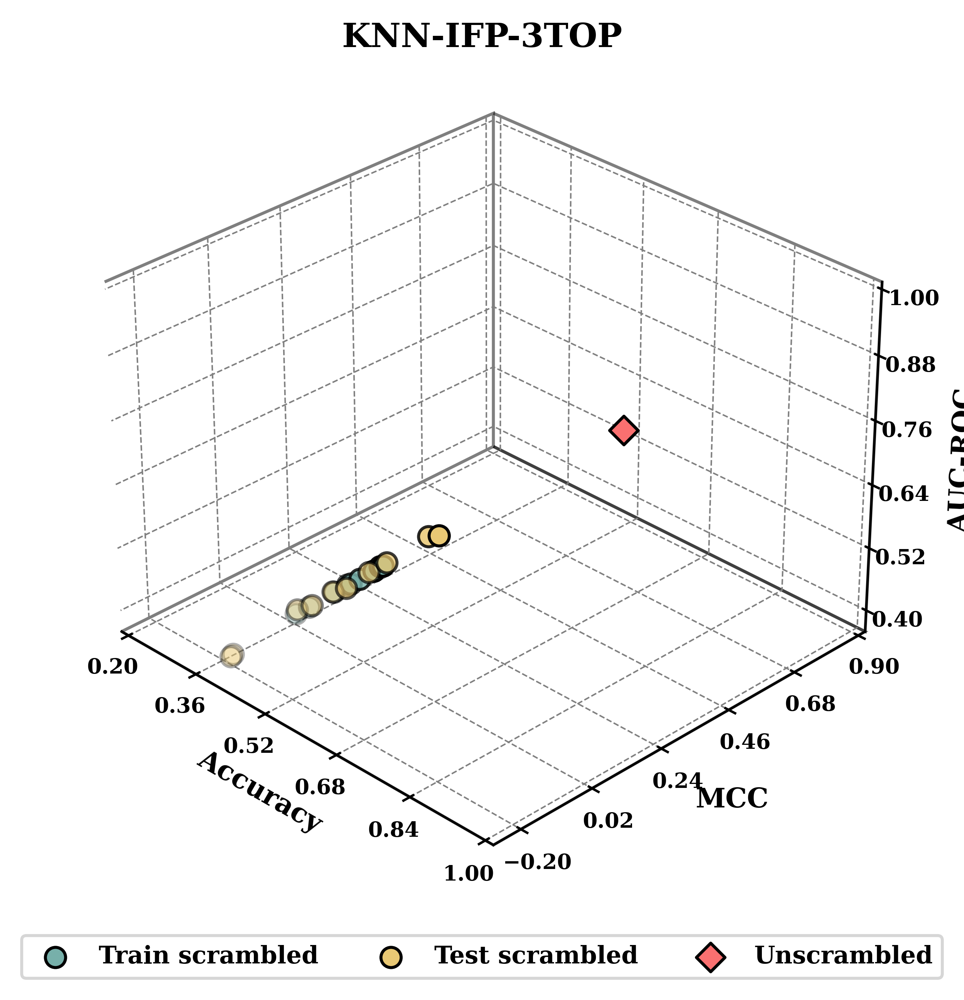

In [82]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import numpy as np

# 加载结果数据
train_results = pd.read_csv('./CtMGAM-IFP/KNN/train_random_scrambled_metrics.csv')
test_results = pd.read_csv('./CtMGAM-IFP/KNN/test_random_scrambled_metrics.csv')
original_train = pd.read_csv('./CtMGAM-IFP/KNN/original_test_model_metrics02.csv', encoding='ISO-8859-1')

# 创建一个大小为8*8，dpi为600的绘图窗口
fig = plt.figure(figsize=(5, 5), dpi=600)
# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')
# 设定3D坐标系的所有边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 在绘图窗口上创建一个3D坐标系
#ax = fig.add_subplot(111, projection='3d')

# 读取训练集、测试集和原始数据的扰动指标
scatter_train = ax.scatter(
    train_results['accuracy'],
    train_results['mcc'],
    train_results['roc_auc'],
    c='#77B0AA',  # Color for training data
    label='Train scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)
scatter_test = ax.scatter(
    test_results['accuracy'],
    test_results['mcc'],
    test_results['roc_auc'],
    c='#E9C874',  # Color for testing data
    label='Test scrambled',
    marker='o',
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 读取原始指标
accuracy = float(original_train.loc[original_train['Metric'] == 'Accuracy', 'Value'].values[0])
mcc = float(original_train.loc[original_train['Metric'] == 'MCC', 'Value'].values[0])
roc_auc = float(original_train.loc[original_train['Metric'] == 'ROC AUC', 'Value'].values[0])
scatter_original_train = ax.scatter(
    accuracy,
    mcc,
    roc_auc,
    c='#FA7070',  # Color for original training data
    label='Unscrambled',
    marker='D',  # Diamond shape,
    s=45,  # 设置点的大小为100，可以根据需要调整大小
    depthshade=True,  # 启用深度阴影
    edgecolors='k'  # 点的边缘颜色设置为黑色
)

# 设置网格为虚线
# 更改网格线为虚线
# ax.xaxis._axinfo["grid"]['linestyle'] = "--"
# ax.yaxis._axinfo["grid"]['linestyle'] = "--"
# ax.zaxis._axinfo["grid"]['linestyle'] = "--"
# 设置网格线虚线样式和强度
ax.xaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.yaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.zaxis._axinfo["grid"].update({'linestyle': "--", 'linewidth': 0.5, 'color': 'gray'})
ax.grid(True)

# 设置图例横向显示在图形下面
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.04), ncol=3,fontsize=8)
# 设置图的标题
plt.title('KNN-IFP-3TOP', fontsize=11, fontweight='bold', pad=-100)
# 设置XYZ轴的刻度
ax.set_xticks(np.linspace(0.2, 1.0, num=6))  #Acc
ax.set_yticks(np.linspace(-0.2, 0.9, num=6))  #MCC
ax.set_zticks(np.linspace(0.4, 1.0, num=6))  #AUC

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设定3D坐标系的视角
#azim（方位角）: 控制图形的左右旋转。数值的增减影响视图绕z轴的旋转，可以理解为观察者围绕对象水平移动的角度。
#elev（高度角）: 控制图形的上下旋转。数值的增减影响视图沿y轴的旋转，可以理解为观察者围绕对象垂直移动的角度。
ax.view_init(azim=-45, elev=30) 
#ax.view_init(azim=-50 ,elev=30) 

# 设置坐标轴标签
ax.set_xlabel('Accuracy', fontweight='bold', fontsize=9, labelpad=-6)
ax.set_ylabel('MCC', fontweight='bold', fontsize=9, labelpad=-4)
ax.set_zlabel('AUC-ROC', fontweight='bold', fontsize=9, labelpad=-4)
# 设置刻度标签大小
ax.tick_params(axis='both', which='major', labelsize=7)
# 设置X, Y, Z轴刻度标签距离坐标轴的距离
ax.tick_params(axis='x', which='major', pad=-2)  # 设置X轴刻度标签的间距
ax.tick_params(axis='y', which='major', pad=-2)  # 设置Y轴刻度标签的间距
ax.tick_params(axis='z', which='major', pad=-2)  # 设置Z轴刻度标签的间距

# Saving the plot as SVG with a high quality
plt.savefig("./CtMGAM-IFP/KNN/KNN-IFP-3TOP.svg", format='svg', dpi=600)
plt.show()

### 例子

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib as mpl
mpl.rc('font', size=13)

# 生成随机数据
x = np.random.rand(100)
y = np.random.rand(100)
z = np.random.rand(100)
c = np.random.rand(100)  # 第四维数据，用于颜色映射

# 创建一个大小为10*8，dpi为90的绘图窗口
fig = plt.figure(figsize=(10, 8), dpi=600)

# 在绘图窗口上创建一个3D坐标系
ax = fig.add_subplot(111, projection='3d')  # 正确的方法是在这里指定projection

# 设定3D坐标系的视角
ax.view_init(azim=15, elev=20)

# 将x、y、z轴刻度线外移因子设为0，将刻度线内移因子设为0.4，让图像更美观
ax.xaxis._axinfo['tick']['outward_factor'] = 0
ax.xaxis._axinfo['tick']['inward_factor'] = 0.4
ax.yaxis._axinfo['tick']['outward_factor'] = 0
ax.yaxis._axinfo['tick']['inward_factor'] = 0.4
ax.zaxis._axinfo['tick']['outward_factor'] = 0
ax.zaxis._axinfo['tick']['inward_factor'] = 0.4

# 设定3D坐标系的底部和背面边框颜色为黑色
ax.xaxis.pane.set_edgecolor('k')
ax.yaxis.pane.set_edgecolor('k')
ax.zaxis.pane.set_edgecolor('k')

# 将三维图的墙壁设置为透明
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# 设置网格为虚线
ax.grid(True, linestyle='--', color='grey', linewidth=0.5)

# 在3D坐标系上绘制散点图
p = ax.scatter3D(x, y, z, c=c, s=100, cmap='RdYlBu_r', edgecolor='k', alpha=0.8)

# 添加颜色条
cbar = fig.colorbar(p, shrink=0.5, aspect=10)
cbar.set_label('wlabel')

# 设置坐标轴标签
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

plt.show()